In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
from scipy import stats

In [2]:
r310=sc.read_h5ad("N_ribas310_clones.h5")

In [14]:
aaa=sc.read_h5ad("BALALA")

In [50]:
apre=subsample(aaa,"orig.ident",'ribas_310_on_later_previd_3_GEX',)

In [51]:
rpre=subsample(r310,"orig.ident",'ribas_310_on_later_previd_3_GEX',)

In [52]:
a1=[i.split("-")[0] for i in apre.obs_names]
a2=[i.split("-")[0] for i in rpre.obs_names]

In [57]:
len(a2)

4447

In [54]:
len(np.intersect1d(a1,a2))

4330

In [44]:
np.unique(aaa.obs["orig.ident"])

array(['ribas_310_on_GEX_5pv2_S27_L004',
       'ribas_310_on_later_previd_3_GEX',
       'ribas_310_pre_GEX_5pv2_S26_L004'], dtype=object)

In [30]:
len(np.intersect1d(a1,a2))

20619

In [44]:
#sc.pp.filter_genes(r310,min_cells=r310.shape[0]*.05)

In [65]:
r310.write_h5ad("N_ribas310_clones.h5")

In [40]:
zscr=sc.pp.scale(r310,copy=True)

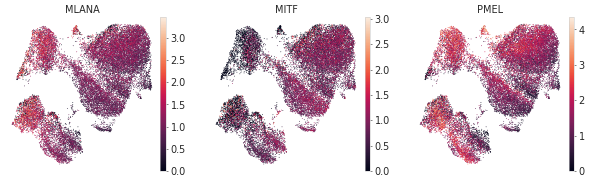

In [84]:
sc.pl.umap(r310,color=['MLANA', 'MITF','PMEL'])

In [3]:
sigs=pd.read_csv("azizi_preprint_sigs_all.csv",index_col=[1])
sigs=sigs.drop('Unnamed: 0',axis=1)

In [4]:
redo=sigs.iloc[0:4]

In [5]:
sigs=sigs.drop(redo.index,axis=0)

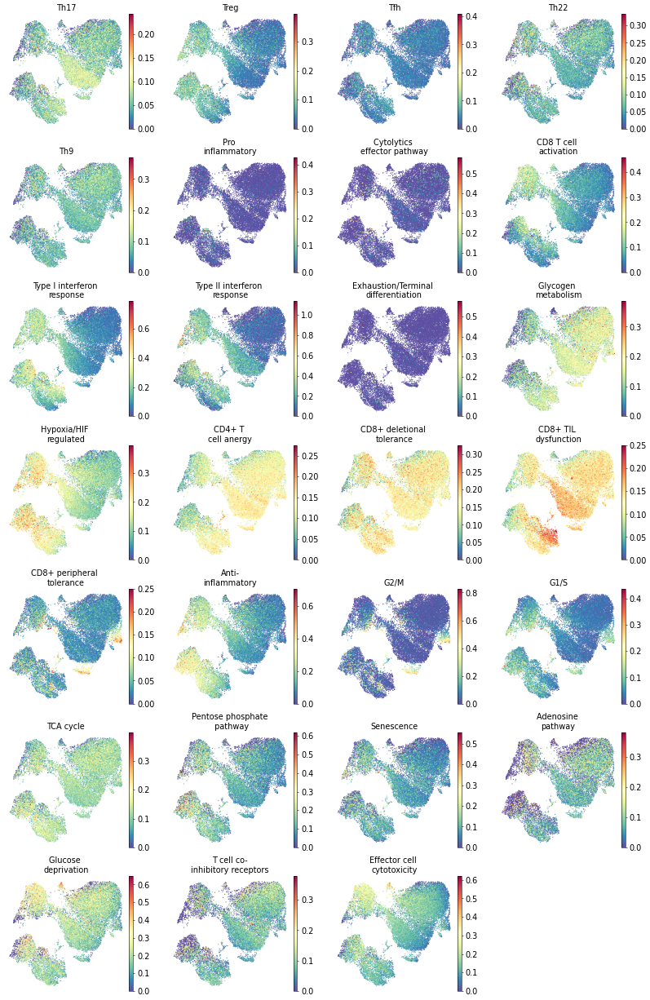

In [6]:
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(sigs)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if pd.isnull(sigs_np[i][j])==False:
            if sigs_np[i][j] in adata_df.columns:
                temp.append(adata_df[sigs_np[i][j]])
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=sigs.index)

signatures_types=sigs.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=sigs.index,
    palette='tab20', color_map='Spectral_r',
    s=10,
    save='r310_sigs1.pdf'
)

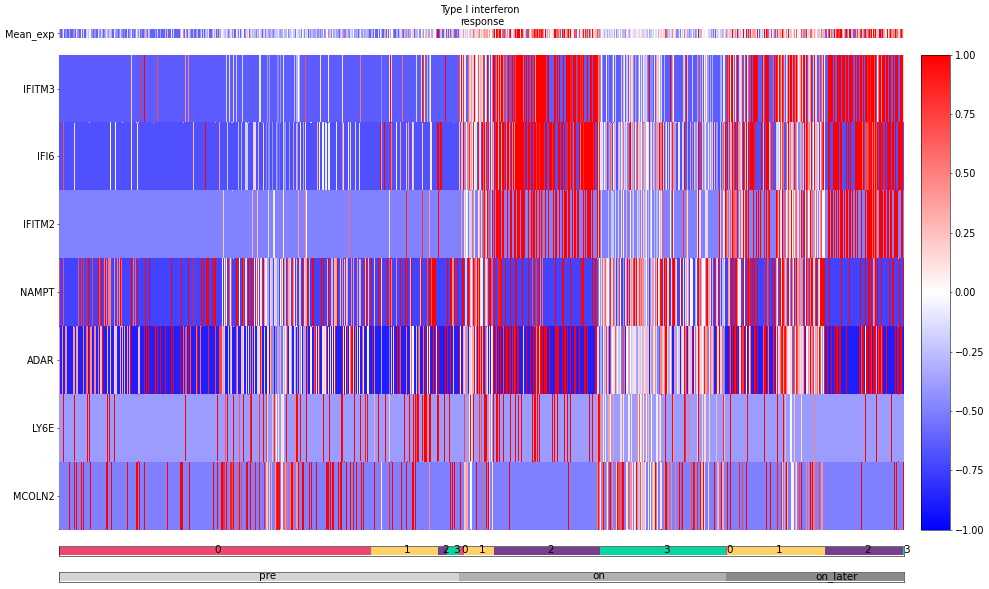

In [106]:
genes=full_heatmap(sigs, "Type I interferon \nresponse",r310,vmax=1)

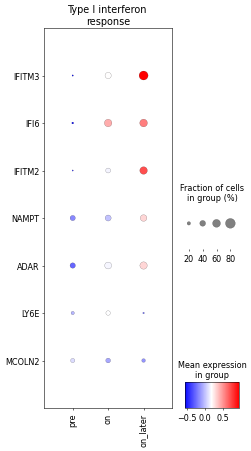

In [107]:
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Type I interferon \nresponse")

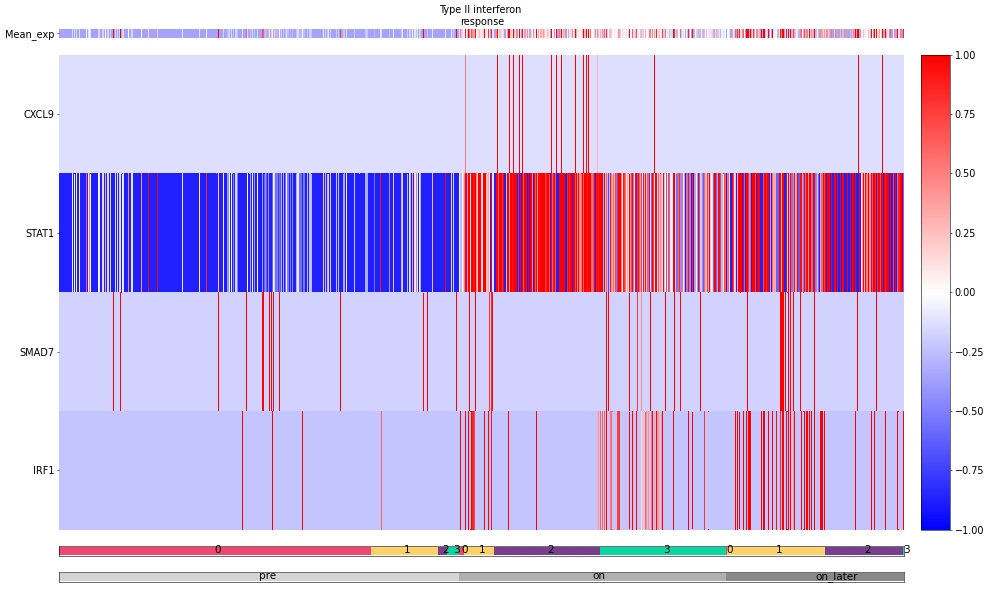

In [108]:
genes=full_heatmap(sigs, "Type II interferon \nresponse",r310,vmax=1,mean_thresh=.01)

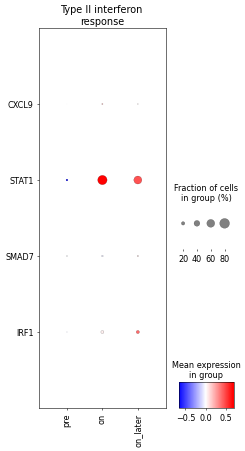

In [109]:
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Type II interferon \nresponse")

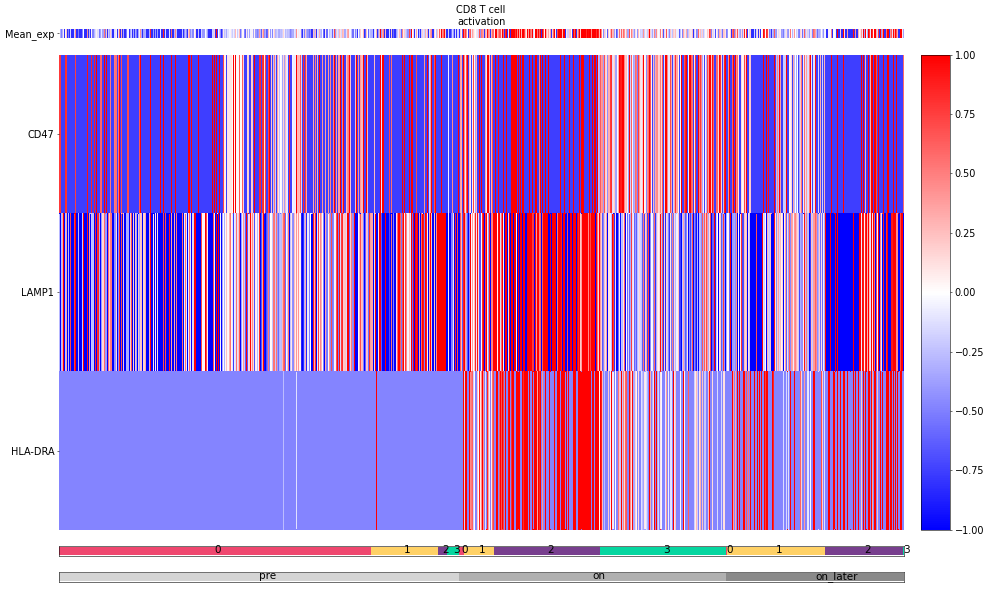

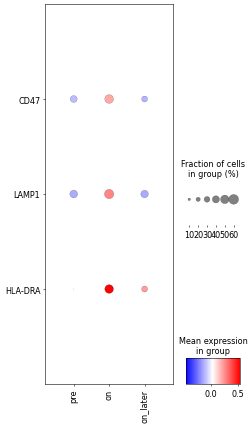

In [110]:
genes=full_heatmap(sigs, "CD8 T cell \nactivation",r310,vmax=1,mean_thresh=.02)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr')

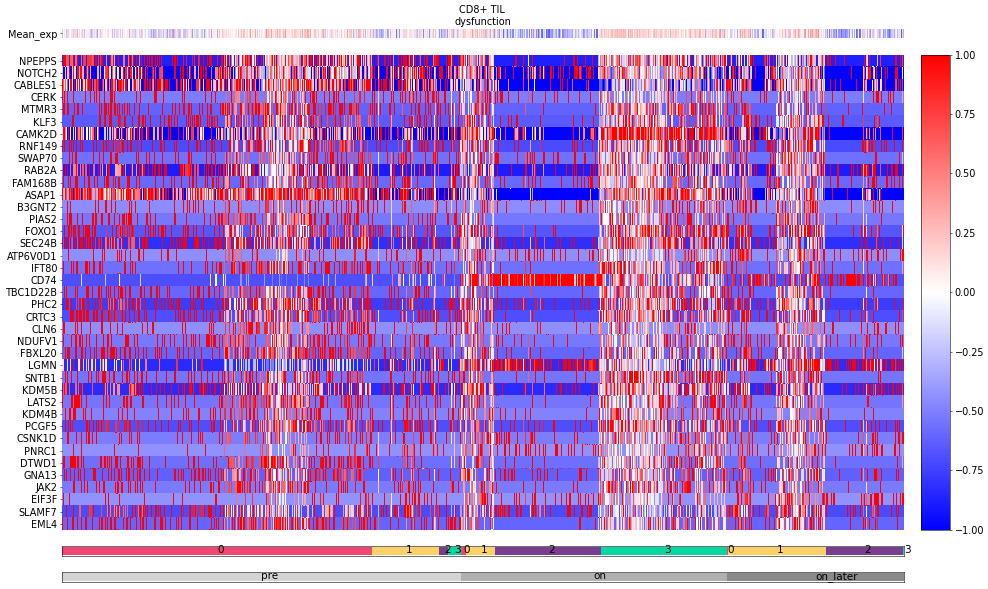

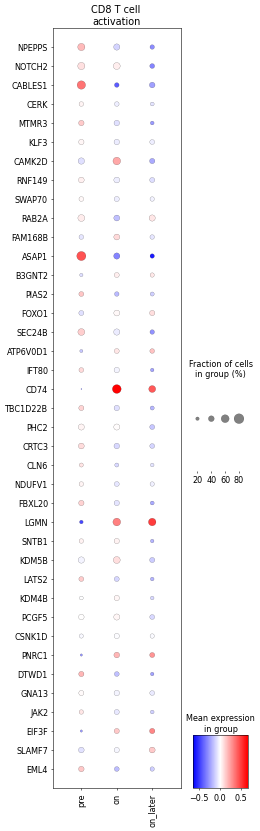

In [111]:
genes=full_heatmap(sigs, "CD8+ TIL \ndysfunction",r310,vmax=1,thresh=500)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,20),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="CD8 T cell \nactivation")

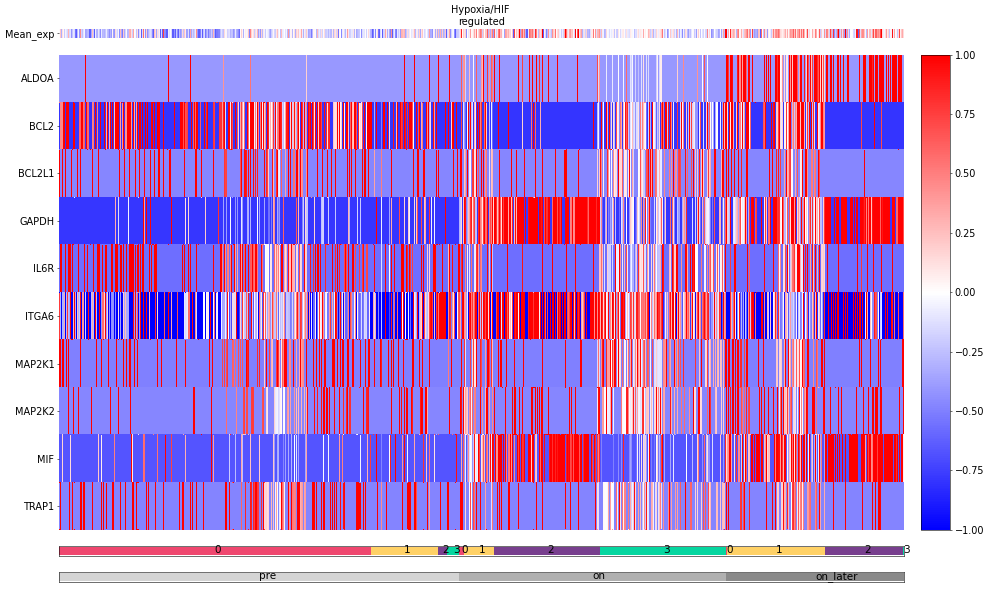

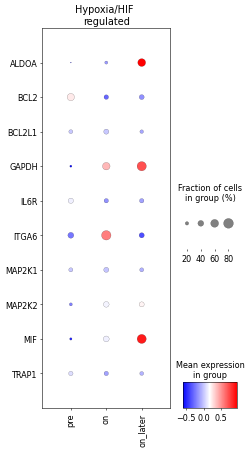

In [112]:
genes=full_heatmap(sigs, "Hypoxia/HIF \nregulated",r310,thresh=1000,vmax=1)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Hypoxia/HIF \nregulated")

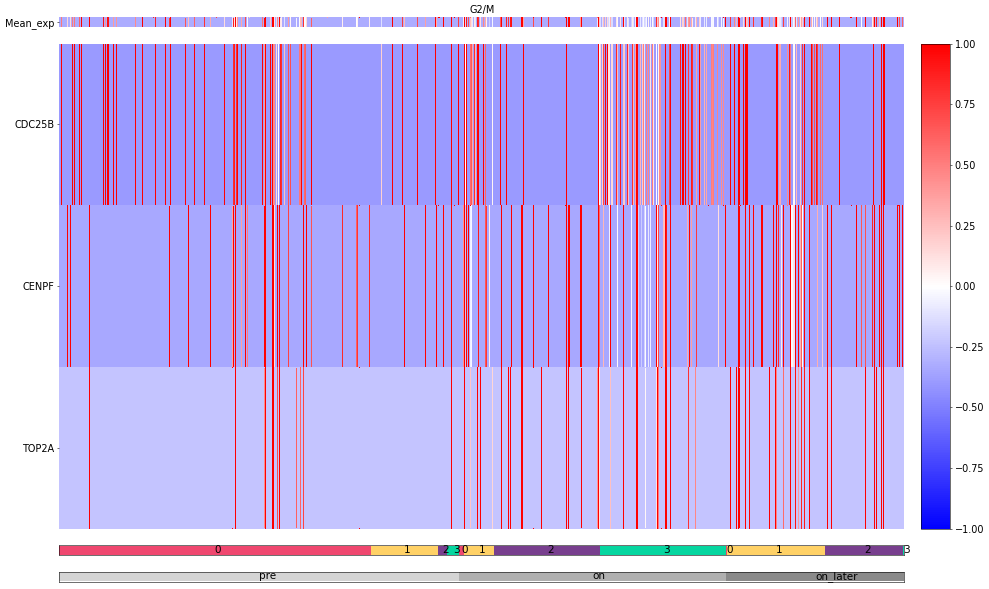

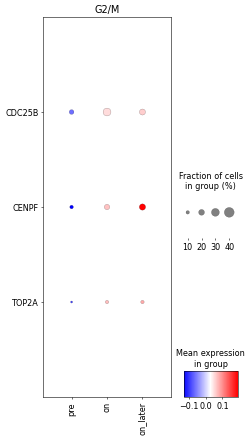

In [113]:
genes=full_heatmap(sigs, "G2/M",r310,vmax=1,mean_thresh=.04)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="G2/M")

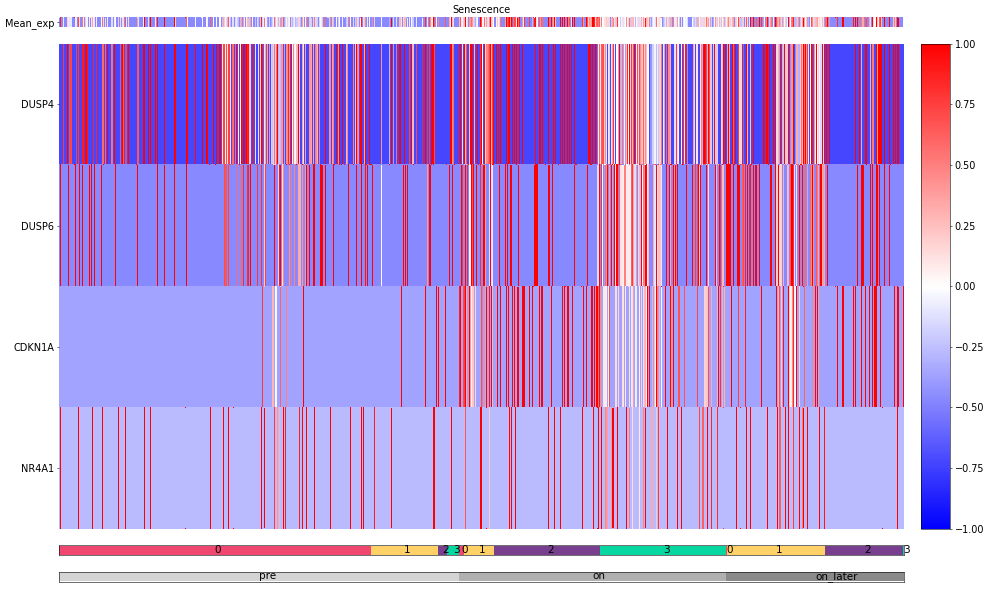

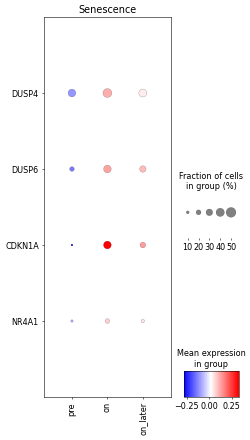

In [114]:
genes=full_heatmap(sigs, "Senescence",r310,vmax=1,thresh=600,mean_thresh=.04)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Senescence")

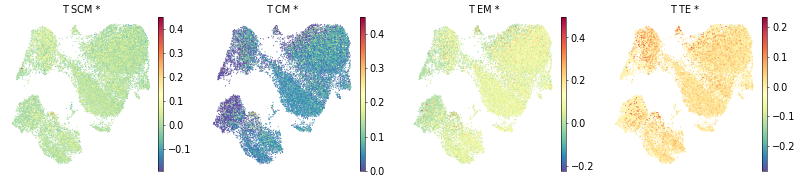

In [115]:
#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(redo)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if pd.isnull(sigs_np[i][j])==False:
            name=sigs_np[i][j].split(" ")[0]
            sign=sigs_np[i][j].split(" ")[1]
            if name in adata_df.columns:
                if sign=="+":
                    temp.append(adata_df[name])
                elif sign=="-":
                    temp.append(-1*adata_df[name])
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=redo.index)

signatures_types=redo.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=redo.index,
    palette='tab20', color_map='Spectral_r',
    s=10,
    save='.pdf'
)

In [116]:
ifn_sigs=pd.read_csv("CIN.csv", index_col=0, header=None)
ifn_sigs=ifn_sigs.drop(1,axis=1)

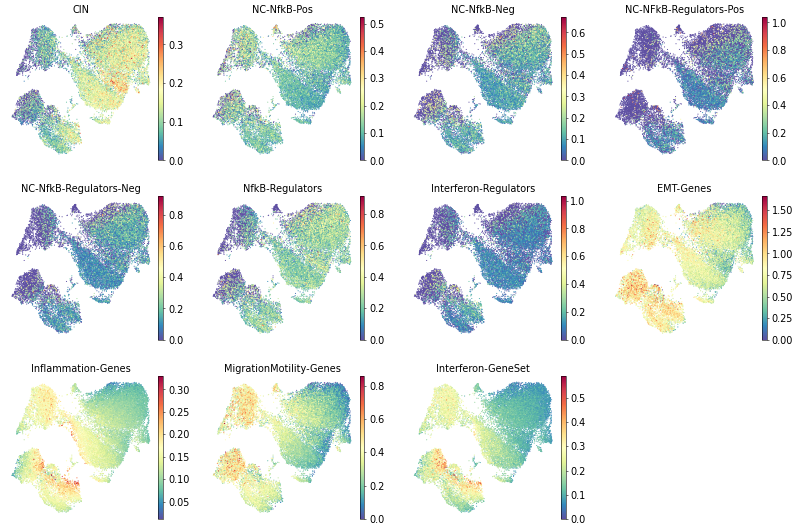

In [118]:
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(ifn_sigs)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if pd.isnull(sigs_np[i][j])==False:
            if sigs_np[i][j] in adata_df.columns:
                temp.append(adata_df[sigs_np[i][j]])
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=ifn_sigs.index)

signatures_types=ifn_sigs.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=ifn_sigs.index,
    palette='tab20', color_map='Spectral_r', 
    s=10,
    save='r310supp2.pdf'
)

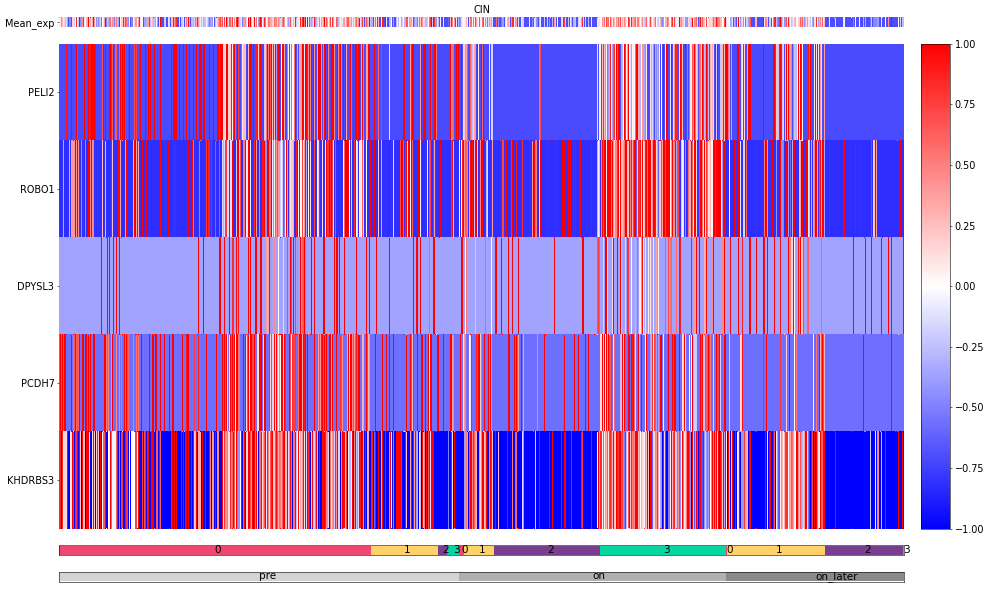

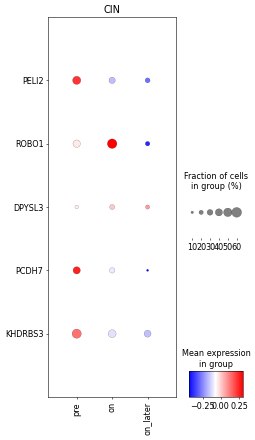

In [125]:
genes=full_heatmap(ifn_sigs, "CIN",r310,vmax=1,mean_thresh=0.07)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="CIN")

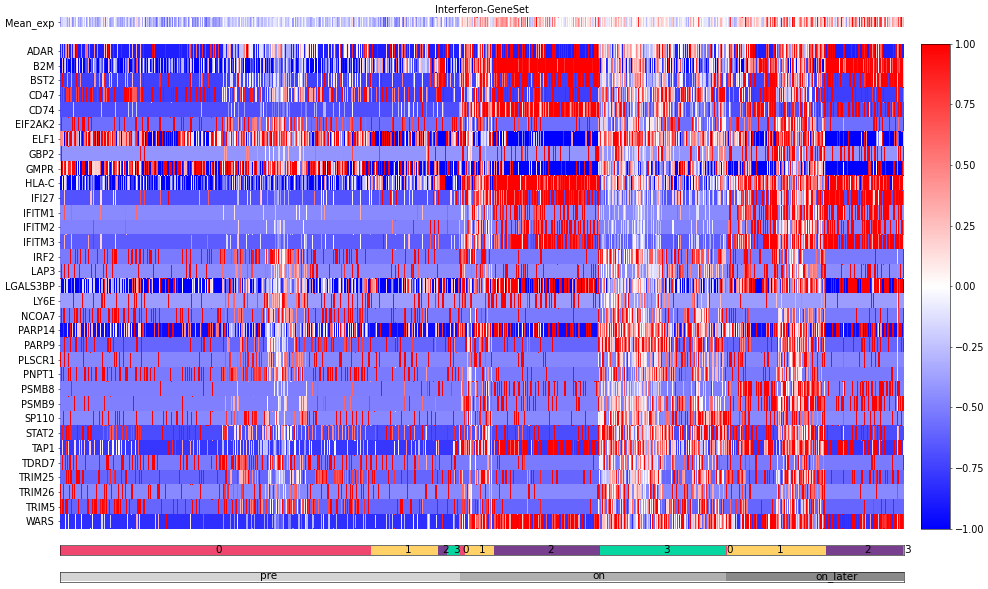

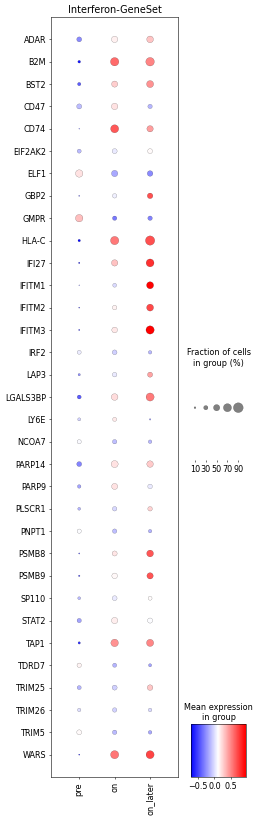

In [120]:
genes=full_heatmap(ifn_sigs, "Interferon-GeneSet",r310,vmax=1)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,20),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Interferon-GeneSet")

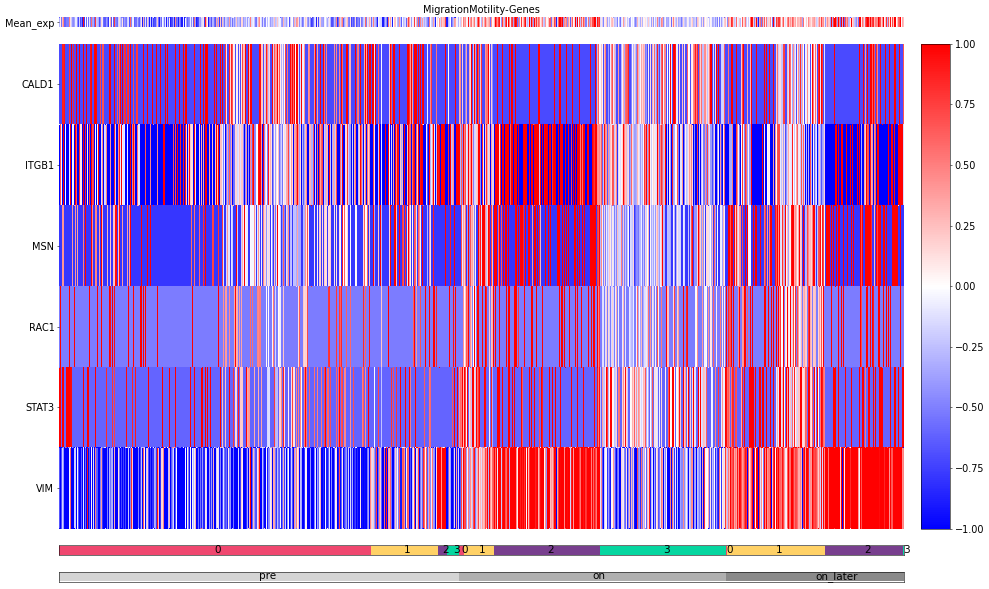

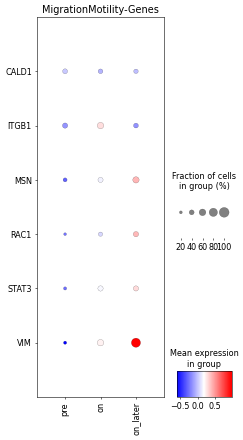

In [121]:
genes=full_heatmap(ifn_sigs, "MigrationMotility-Genes",r310,vmax=1)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="MigrationMotility-Genes")

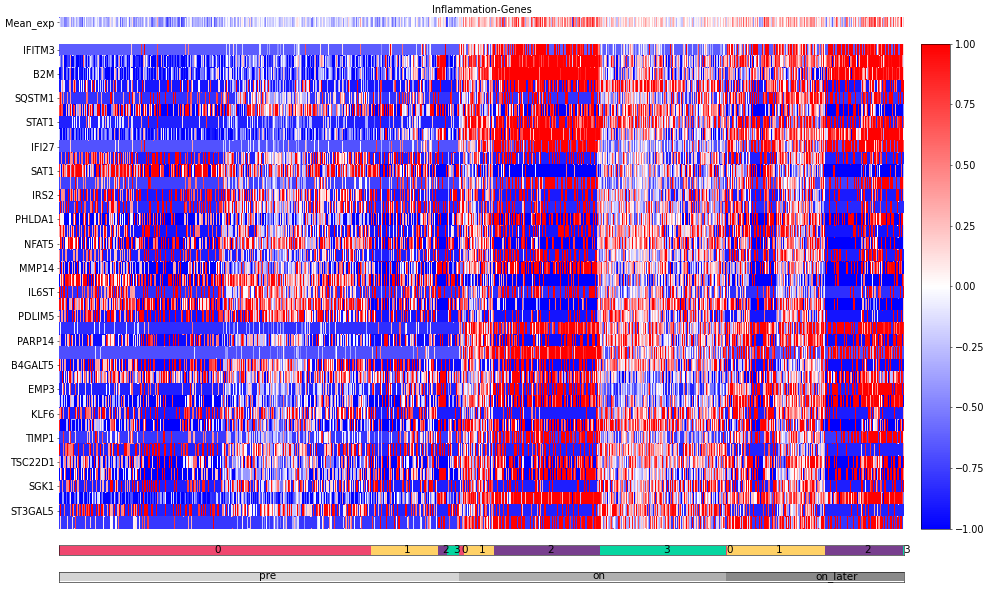

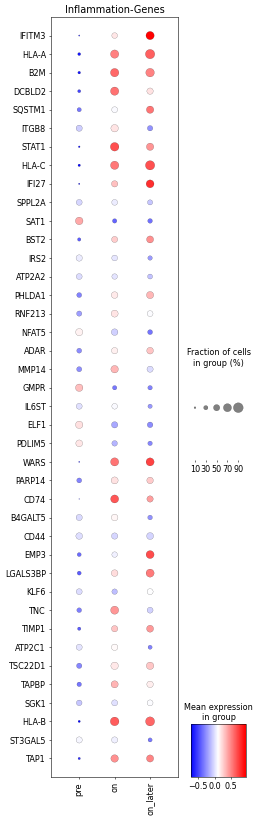

In [133]:
genes=full_heatmap(ifn_sigs, "Inflammation-Genes",r310,vmax=1,mean_thresh=.31)
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,20),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Inflammation-Genes")

In [3]:
mitf_sigs=pd.read_csv("MITF_AXL_signatures.csv", index_col=None, header=0)
mitf_sigs=np.transpose(mitf_sigs)
mitf_sigs

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
AXL_sig,ANGPTL4,FSTL3,GPC1,TMSB10,SH3BGRL3,PLAUR,NGFR,SEC14L2,FOSL1,SERPINE1,...,P4HA2,PEA15,GLRX2,HAPLN3,RAB36,SOD2,ESYT2,IL18BP,FGFRL1,PLEC
MITF_sig,MITF,TYR,PMEL,PLP1,GPR143,MLANA,STX7,IRF4,ERBB3,CDH1,...,HACD3,SNCA,GNPTAB,DNAJA4,APOE,MTMR2,ATP6V1B2,VPS35L,EXOSC4,STAM


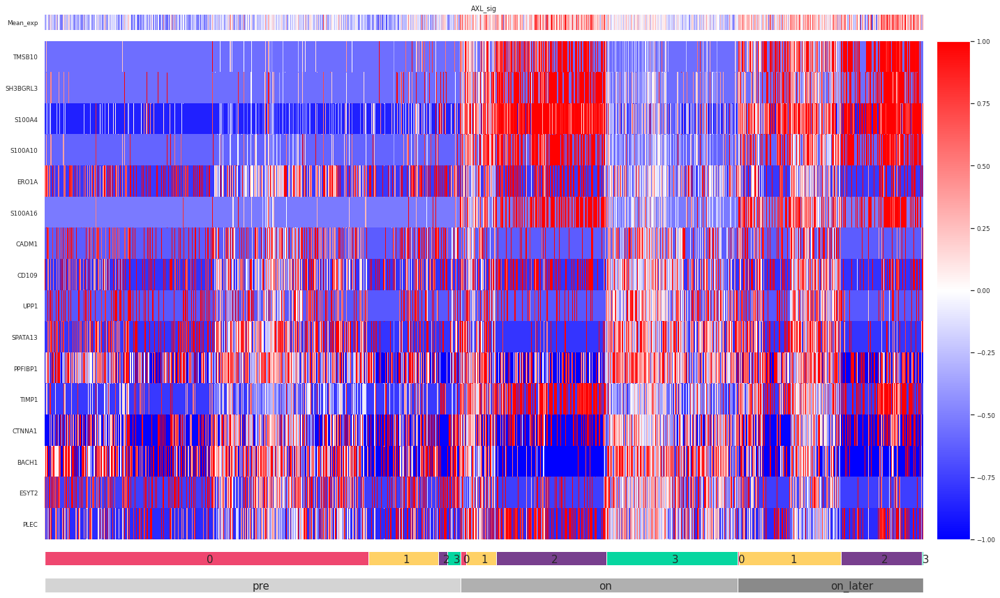

In [29]:
genes=full_heatmap(mitf_sigs, "AXL_sig",r310,vmax=1,mean_thresh=.2)

In [16]:
mitf_sigs

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
AXL_sig,ANGPTL4,FSTL3,GPC1,TMSB10,SH3BGRL3,PLAUR,NGFR,SEC14L2,FOSL1,SERPINE1,...,P4HA2,PEA15,GLRX2,HAPLN3,RAB36,SOD2,ESYT2,IL18BP,FGFRL1,PLEC
MITF_sig,MITF,TYR,PMEL,PLP1,GPR143,MLANA,STX7,IRF4,ERBB3,CDH1,...,HACD3,SNCA,GNPTAB,DNAJA4,APOE,MTMR2,ATP6V1B2,VPS35L,EXOSC4,STAM


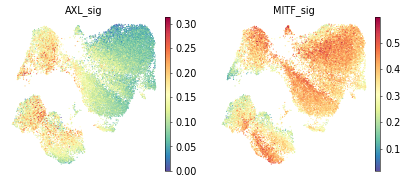

In [17]:
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(mitf_sigs)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if pd.isnull(sigs_np[i][j])==False:
            if sigs_np[i][j] in adata_df.columns:
                temp.append(adata_df[sigs_np[i][j]])
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=mitf_sigs.index)

signatures_types=mitf_sigs.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=mitf_sigs.index,
    palette='tab20', color_map='Spectral_r', 
    s=10,
    #save='r310supp3.pdf'
)

In [19]:
signatures

array([[0.17227885, 0.33322465],
       [0.10495207, 0.3650801 ],
       [0.15228443, 0.31168437],
       ...,
       [0.08048326, 0.38211074],
       [0.0327086 , 0.23596273],
       [0.0475843 , 0.25041467]], dtype=float32)

In [11]:
exh_sigs=pd.read_csv("Tcell_exhaustion_signatures.csv", index_col=None, header=0)
exh_sigs=np.transpose(exh_sigs)

In [16]:
exh_sigs

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
Terminal\nexhaustion,CD3G,FASLG,ID2,LAG3,RGS1,CCL3 CCL3L1,KIAA1671,SH2D2A,DUSP2,PDCD1,...,EFHD2,GLRX,CXCR6,ARL6IP1,CCL4,ISG15,LAX1,CD8A,SERPINA3,GZMB
Precursor\nexhaustion,TCF7,MS4A4A,TNFSF8,CXCL10,EEF1B2,ID3,IL7R,JUN,LTB,XCL1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


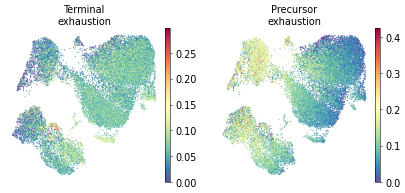

In [12]:
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(exh_sigs)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if pd.isnull(sigs_np[i][j])==False:
            if sigs_np[i][j] in adata_df.columns:
                temp.append(adata_df[sigs_np[i][j]])
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=exh_sigs.index)

signatures_types=exh_sigs.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=exh_sigs.index,
    palette='tab20', color_map='Spectral_r', 
    s=10,
    save='r310supp3.pdf'
)

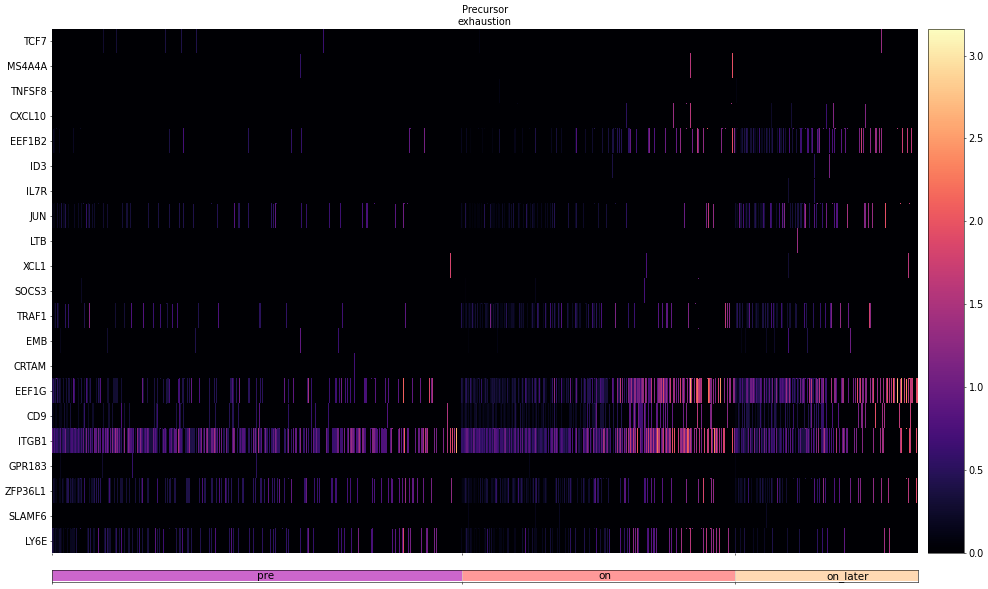

In [17]:
full_heatmap(exh_sigs, "Precursor\nexhaustion",r310)

In [4]:
other_sigs=pd.read_csv("Grasso_Arnon_sigs.csv",header=None,nrows=9,index_col=0)

In [5]:
other_sigs

,1,2,3,4,5,6,7,8,9,10,...,1716,1717,1718,1719,1720,1721,1722,1723,1724,1725
0,,,,,,,,,,,,,,,,,,,,,
Anti-proliferative,G1/S,G2/M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Antigen presentation,B2M,HLA-A,HLA-B,HLA-C,HLA-E,HLA-F,HLA-G,HLA-DPA1,HLA-DPB1,HLA-DQA2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Feedback/signaling,IFNGR1,IFNGR2,JAK1,JAK2,STAT1,STAT2,STAT3,IRF1,IRF2,IRF3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Chemoattractants,SOCS1,SOCS3,CCL2,CXCL1,CXCL8,CXCL9,CXCL10,CXCL11,CXCL16,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Cytotoxic effectors,IFNGR1,TNF,FAS,TNFSF10,PRF1,GZMA,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Immune resistance (up),BZW2,CCT3,CDK4,GPATCH4,ISYNA1,MDH2,PPIA,RPL31,RPL37A,RPL41,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Immune resistance (down),AHNAK,APOD,ATP1A1,B2M,CD44,CD63,CTSB,CTSD,FOS,GRN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
IFN-g,SAMD9L,RTP4,IFIT3,PARP14,GBP2,WARS,BATF2,IRF1,TAP1,APOL6,...,WDR25,DDX60L,SAMD9,XRN1,DOCK10,IFI16,TMEM158,TNFRSF21,ATOH8,DAAM2
Glycolysis,ALDOA,ALDOC,BPGM,ENO1,ENO2,GALM,GCK,GPI,HK2,HK3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [55]:
exh_sigs=other_sigs.iloc[[0,1,2,3,4,7,8]]

In [56]:
exh_sigs

,1,2,3,4,5,6,7,8,9,10,...,1716,1717,1718,1719,1720,1721,1722,1723,1724,1725
0,,,,,,,,,,,,,,,,,,,,,
Anti-proliferative,G1/S,G2/M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Antigen presentation,B2M,HLA-A,HLA-B,HLA-C,HLA-E,HLA-F,HLA-G,HLA-DPA1,HLA-DPB1,HLA-DQA2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Feedback/signaling,IFNGR1,IFNGR2,JAK1,JAK2,STAT1,STAT2,STAT3,IRF1,IRF2,IRF3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Chemoattractants,SOCS1,SOCS3,CCL2,CXCL1,CXCL8,CXCL9,CXCL10,CXCL11,CXCL16,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Cytotoxic effectors,IFNGR1,TNF,FAS,TNFSF10,PRF1,GZMA,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
IFN-g,SAMD9L,RTP4,IFIT3,PARP14,GBP2,WARS,BATF2,IRF1,TAP1,APOL6,...,WDR25,DDX60L,SAMD9,XRN1,DOCK10,IFI16,TMEM158,TNFRSF21,ATOH8,DAAM2
Glycolysis,ALDOA,ALDOC,BPGM,ENO1,ENO2,GALM,GCK,GPI,HK2,HK3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


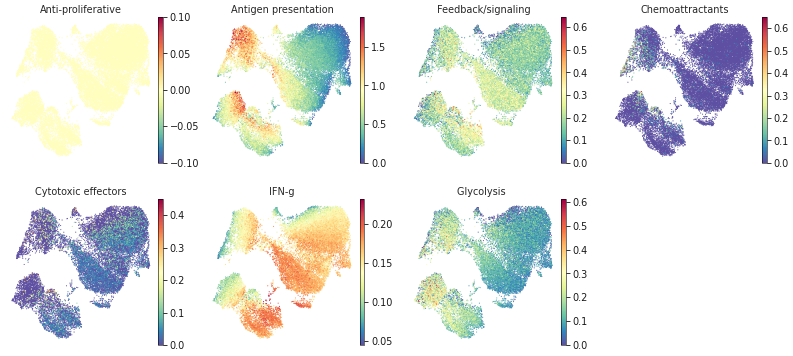

In [57]:
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(exh_sigs)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if pd.isnull(sigs_np[i][j])==False:
            if sigs_np[i][j] in adata_df.columns:
                temp.append(adata_df[sigs_np[i][j]])
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=exh_sigs.index)

signatures_types=exh_sigs.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=exh_sigs.index,
    palette='tab20', color_map='Spectral_r', 
    s=10,
    save='r310supp3.pdf'
)

In [164]:
#genes=[i for i in exh_sigs.loc["Antigen presentation"] if not pd.isnull(i) and i in r310.var_names]


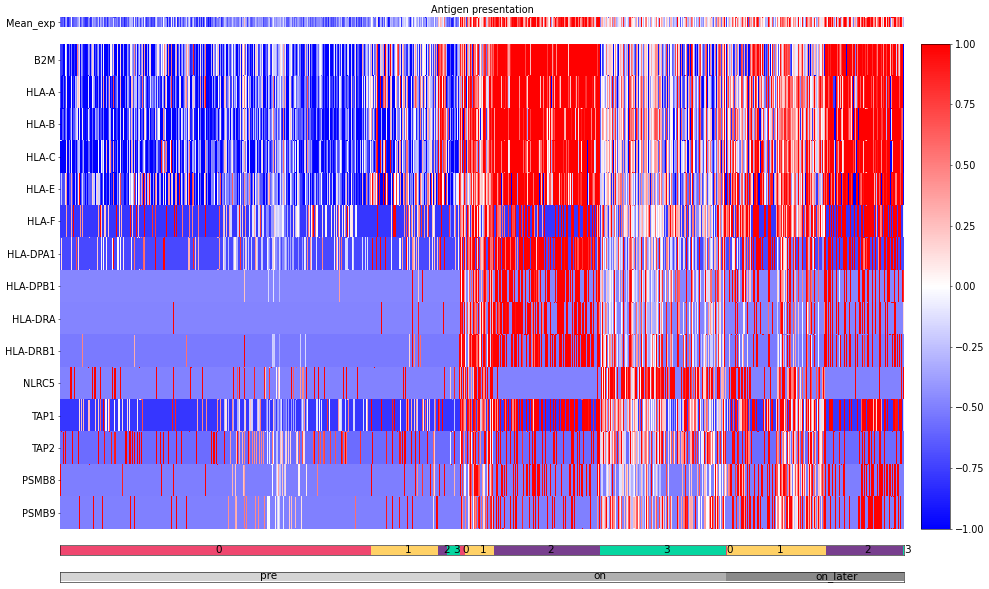

In [139]:
genes=full_heatmap(exh_sigs, "Antigen presentation",r310,vmax=1,thresh=300)

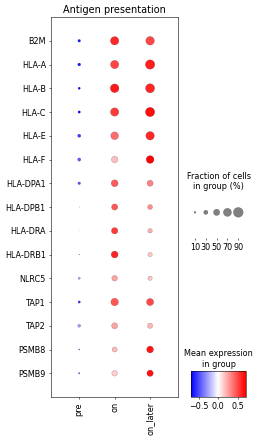

In [140]:
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,10),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Antigen presentation")

In [30]:
imm_res=other_sigs.iloc[[5,6]]

In [11]:
mitf_sigs

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
AXL_sig,ANGPTL4,FSTL3,GPC1,TMSB10,SH3BGRL3,PLAUR,NGFR,SEC14L2,FOSL1,SERPINE1,...,P4HA2,PEA15,GLRX2,HAPLN3,RAB36,SOD2,ESYT2,IL18BP,FGFRL1,PLEC
MITF_sig,MITF,TYR,PMEL,PLP1,GPR143,MLANA,STX7,IRF4,ERBB3,CDH1,...,HACD3,SNCA,GNPTAB,DNAJA4,APOE,MTMR2,ATP6V1B2,VPS35L,EXOSC4,STAM


In [10]:
mitf_sigs.iloc[[0]]

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
AXL_sig,ANGPTL4,FSTL3,GPC1,TMSB10,SH3BGRL3,PLAUR,NGFR,SEC14L2,FOSL1,SERPINE1,...,P4HA2,PEA15,GLRX2,HAPLN3,RAB36,SOD2,ESYT2,IL18BP,FGFRL1,PLEC


In [32]:
imm_res=pd.concat((imm_res.iloc[[0]],mitf_sigs.iloc[[0]]))

In [33]:
imm_res

,0,1,2,3,4,5,6,7,8,9,...,1716,1717,1718,1719,1720,1721,1722,1723,1724,1725
Immune resistance (up),NaN,BZW2,CCT3,CDK4,GPATCH4,ISYNA1,MDH2,PPIA,RPL31,RPL37A,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AXL_sig,ANGPTL4,FSTL3,GPC1,TMSB10,SH3BGRL3,PLAUR,NGFR,SEC14L2,FOSL1,SERPINE1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


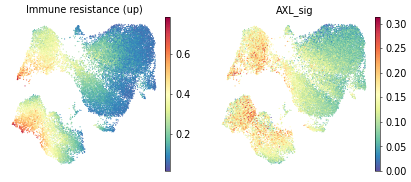

In [35]:
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(imm_res)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if pd.isnull(sigs_np[i][j])==False:
            if sigs_np[i][j] in adata_df.columns:
                temp.append(adata_df[sigs_np[i][j]]) #for induced genes
                #else:
                 #   temp.append(-1*adata_df[sigs_np[i][j]]) #for downregulated genes(take negative)
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=imm_res.index)

signatures_types=imm_res.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=imm_res.index,
    palette='tab20', color_map='Spectral_r', 
    s=10,
    save='2g.pdf'
)

In [26]:
sigs_np

array([[nan, 'BZW2', 'CCT3', ..., nan, nan, nan],
       ['ANGPTL4', 'FSTL3', 'GPC1', ..., nan, nan, nan]], dtype=object)

In [24]:
signatures

array([[ 0.19493267, -0.17227885],
       [ 0.07678033, -0.10495207],
       [ 0.10281736, -0.15228443],
       ...,
       [ 0.07406819, -0.08048326],
       [ 0.08402637, -0.0327086 ],
       [ 0.03341308, -0.0475843 ]], dtype=float32)

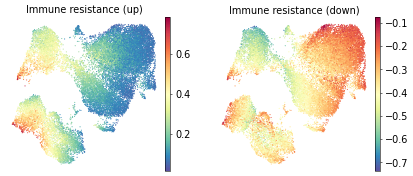

In [31]:
#NOTE: THIS BLOCK HAS A DOWNREGULATED CHECK BC OF IMM RES DOWN
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(imm_res)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if pd.isnull(sigs_np[i][j])==False:
            if sigs_np[i][j] in adata_df.columns:
                if i==0:
                    temp.append(adata_df[sigs_np[i][j]]) #for induced genes
                else:
                    temp.append(-1*adata_df[sigs_np[i][j]]) #for downregulated genes(take negative)
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=imm_res.index)

signatures_types=imm_res.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=imm_res.index,
    palette='tab20', color_map='Spectral_r', 
    s=10,
    save='r310supp3.pdf'
)

In [59]:
sns.set(font_scale=0.7)

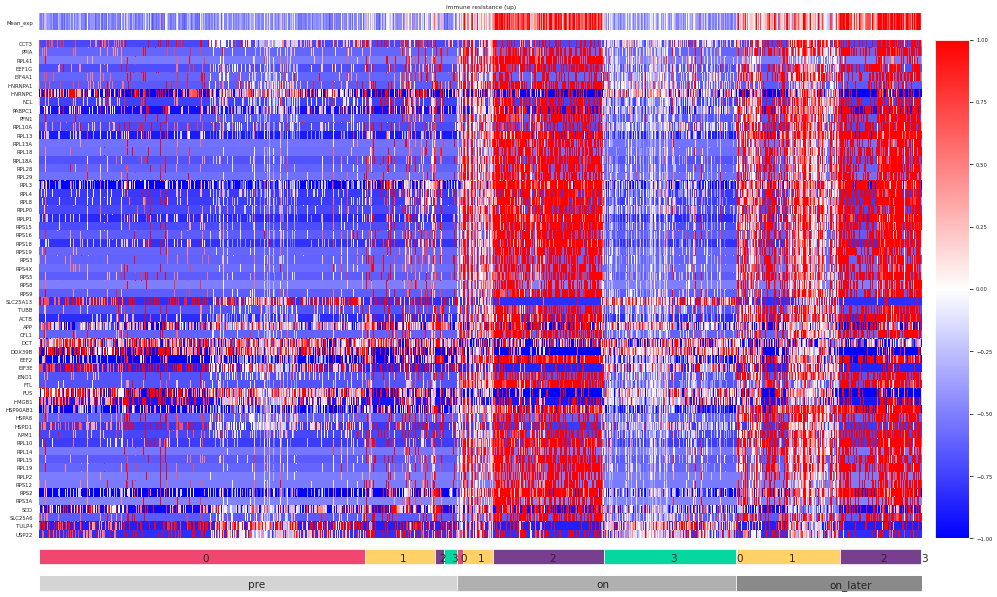

In [61]:
genes=full_heatmap(imm_res, "Immune resistance (up)",r310,vmax=1,mean_thresh=.25)

NameError: name 'zscr' is not defined

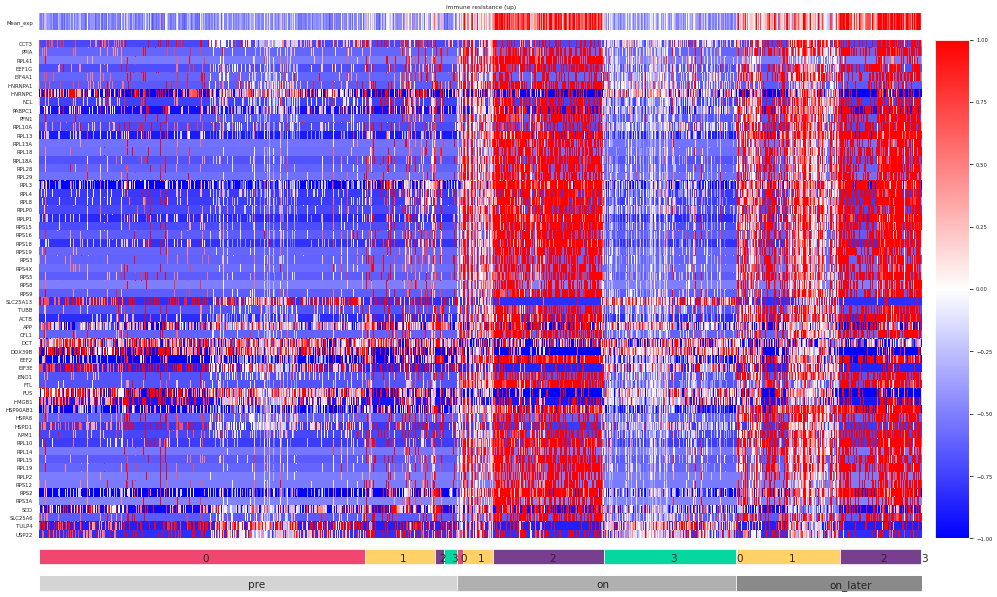

In [60]:
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,20),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Immune resistance (up)")

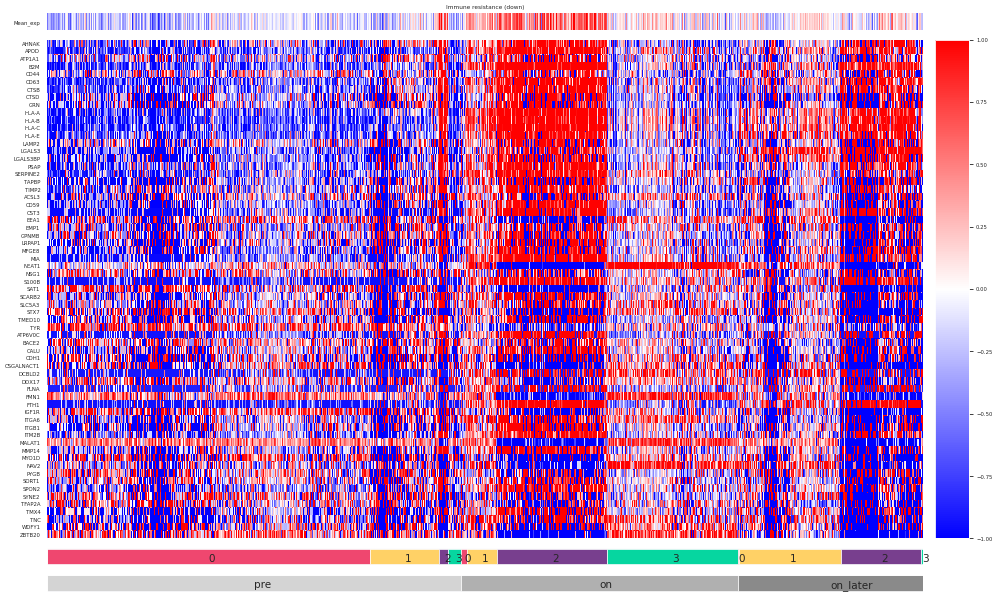

In [63]:
genes=full_heatmap(imm_res, "Immune resistance (down)",r310,vmax=1,mean_thresh=0.5)

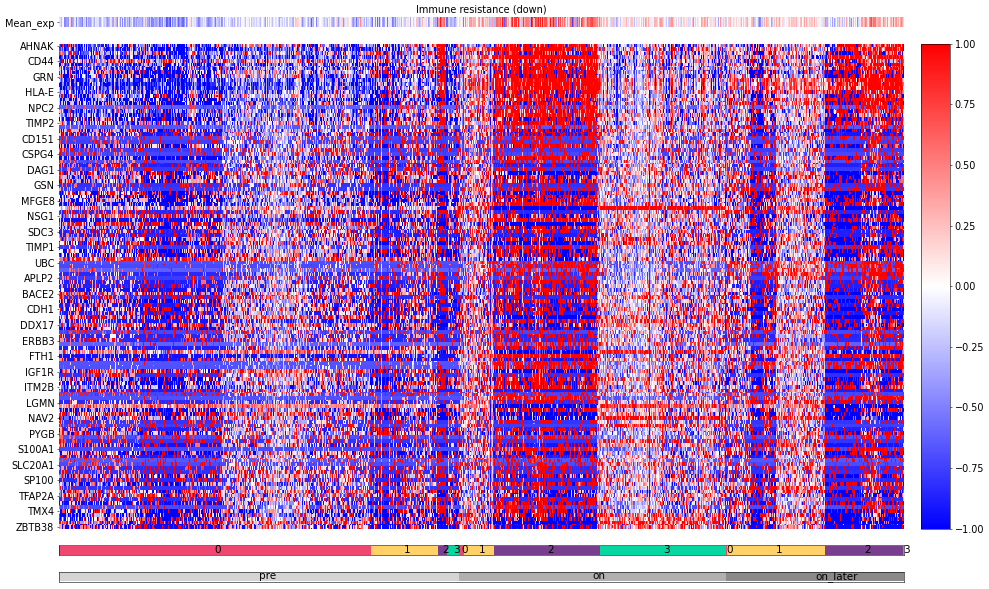

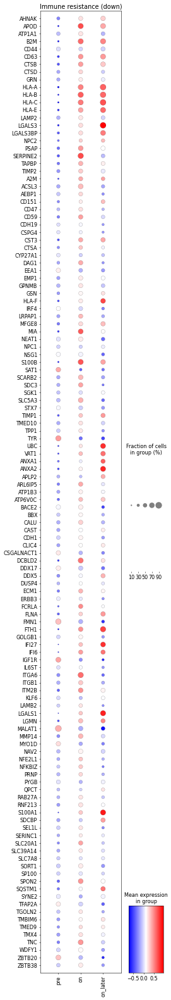

In [148]:
sc.pl.dotplot(zscr,genes,groupby='treatment',
              figsize=(5,40),
              swap_axes=True,
              categories_order=["pre","on","on_later"],
             cmap='bwr',title="Immune resistance (down)")

### GSEA signatures

In [64]:
lengths=[]
for i in range(7481):
    lengths.append(pd.read_csv("c5_go_bp.csv",header=None,nrows=1,skiprows=i,index_col=0,sep='\t').shape[1])

In [65]:
maxx=max(lengths)

In [ ]:
gsea_sigs=pd.DataFrame()
for i in range(7481):
    line=pd.read_csv("c5_go_bp.csv",header=None,nrows=1,skiprows=i,index_col=0,sep='\t')
    gsea_sigs[line.index]=np.append(np.asarray(line).flatten(),np.asarray(["NA" for i in range(maxx-line.shape[1])]))[1:]
    

In [ ]:
gsea_sigs=gsea_sigs.T

In [ ]:
gsea_sigs.to_csv("GO.BP.sigs.READABLE.csv")

In [210]:
interesting=['GOBP_IMMUNE_EFFECTOR_PROCESS',
 'GOBP_CELL_ACTIVATION',
 'GOBP_MYELOID_LEUKOCYTE_MEDIATED_IMMUNITY',
 'GOBP_LEUKOCYTE_MEDIATED_IMMUNITY',
 'GOBP_MYELOID_LEUKOCYTE_ACTIVATION',
 'GOBP_CELL_ACTIVATION_INVOLVED_IN_IMMUNE_RESPONSE',
 'GOBP_RESPONSE_TO_INTERFERON_GAMMA',
 'GOBP_INNATE_IMMUNE_RESPONSE',
 'GOBP_DEFENSE_RESPONSE_TO_OTHER_ORGANISM',
 'GOBP_RESPONSE_TO_BIOTIC_STIMULUS',
 'GOBP_POSITIVE_REGULATION_OF_GENE_EXPRESSION',
 'GOBP_RESPONSE_TO_VIRUS',
 'GOBP_BIOLOGICAL_ADHESION',
 'GOBP_EXOCYTOSIS',
 'GOBP_CYTOKINE_PRODUCTION',
 'GOBP_NEURON_DEVELOPMENT',
 'GOBP_NEUROGENESIS',
 'GOBP_RESPONSE_TO_CYTOKINE',
 'GOBP_REGULATION_OF_CELLULAR_PROTEIN_LOCALIZATION',
 'GOBP_CYTOKINE_MEDIATED_SIGNALING_PATHWAY',
 'GOBP_REGULATION_OF_PROTEIN_CATABOLIC_PROCESS',
 'GOBP_POSITIVE_REGULATION_OF_IMMUNE_RESPONSE',
 'GOBP_RESPONSE_TO_BACTERIUM',
 'GOBP_DEFENSE_RESPONSE',
 'GOBP_CENTRAL_NERVOUS_SYSTEM_DEVELOPMENT']

In [6]:
gsea_sigs=pd.read_csv("GO.BP.sigs.READABLE.csv",index_col=0)

/home/lf2684/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (1189,1190,1191,1192,1193,1194,1195,1196,1197,1198,1199,1200,1201,1202,1203,1204,1205,1206,1207,1208,1209,1210,1211,1212,1213,1214,1215,1216,1217,1218,1219,1220,1221,1222,1223,1224,1225,1226,1227,1228,1229,1230,1231,1232,1233,1234,1235,1236,1237,1238,1239,1240,1241,1242,1243,1244,1245,1246,1247,1248,1249,1250,1251,1252,1253,1254,1255,1256,1257,1258,1259,1260,1261,1262,1263,1264,1265,1266,1267,1268,1269,1270,1271,1272,1273,1274,1275,1276,1277,1278,1279,1280,1281,1282,1283,1284,1285,1286,1287,1288,1289,1290,1291,1292,1293,1294,1295,1296,1297,1298,1299,1300,1301,1302,1303,1304,1305,1306,1307,1308,1309,1310,1311,1312,1313,1314,1315,1316,1317,1318,1319,1320,1321,1322,1323,1324,1325,1326,1327,1328,1329,1330,1331,1332,1333,1334,1335,1336,1337,1338,1339,1340,1341,1342,1343,1344,1345,1346,1347,1348,1349,1350,1351,1352,1353,1354,1355,1356,1357,1358,1359,1360,1361,1362,1363,1364,1365,13

In [7]:
gsea_sigs

,0,1,2,3,4,5,6,7,8,9,...,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981
GOBP_MITOCHONDRIAL_GENOME_MAINTENANCE,AKT3,PPARGC1A,POLG2,PARP1,DNA2,TYMP,PRIMPOL,STOX1,SLC25A4,LIG3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GOBP_REPRODUCTION,ADA,GNPDA1,ZGLP1,SYCE1L,BSPH1,PLA2G4B,BCL2L10,BCL2L11,TSPY10,MAMLD1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GOBP_SINGLE_STRAND_BREAK_REPAIR,AP002495.1,ERCC8,PARP1,APLF,ERCC6,SIRT1,LIG4,APTX,TDP1,TERF2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GOBP_REGULATION_OF_DNA_RECOMBINATION,PARP3,ACTR2,RAD50,ALYREF,MAD2L2,RAD51AP1,POLQ,PRDM7,CHEK1,SHLD3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GOBP_REGULATION_OF_MITOTIC_RECOMBINATION,RAD50,ZSCAN4,ERCC2,MLH1,MRE11,TERF2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GOBP_REGULATION_OF_CYSTEINE_TYPE_ENDOPEPTIDASE_ACTIVITY_INVOLVED_IN_EXECUTION_PHASE_OF_APOPTOSIS,RFFL,PAK2,RFPL1,RPS3,RNF34,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GOBP_REGULATION_OF_UNSATURATED_FATTY_ACID_BIOSYNTHETIC_PROCESS,PIBF1,ABCD1,FABP5,ABCD2,SIRT1,ANXA1,IL1B,MIR132,MIR204,PLA2G3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GOBP_POSITIVE_REGULATION_OF_UNSATURATED_FATTY_ACID_BIOSYNTHETIC_PROCESS,ABCD1,ABCD2,ANXA1,IL1B,PLA2G3,AVP,AVPR1A,PTGS2,CD74,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
GOBP_REGULATION_OF_CAVEOLIN_MEDIATED_ENDOCYTOSIS,CLN3,PROM2,NEDD4L,ITSN1,SRC,CAV3,UNC119,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
exh_sigs=gsea_sigs

In [20]:
sns.set(font_scale=0.8)

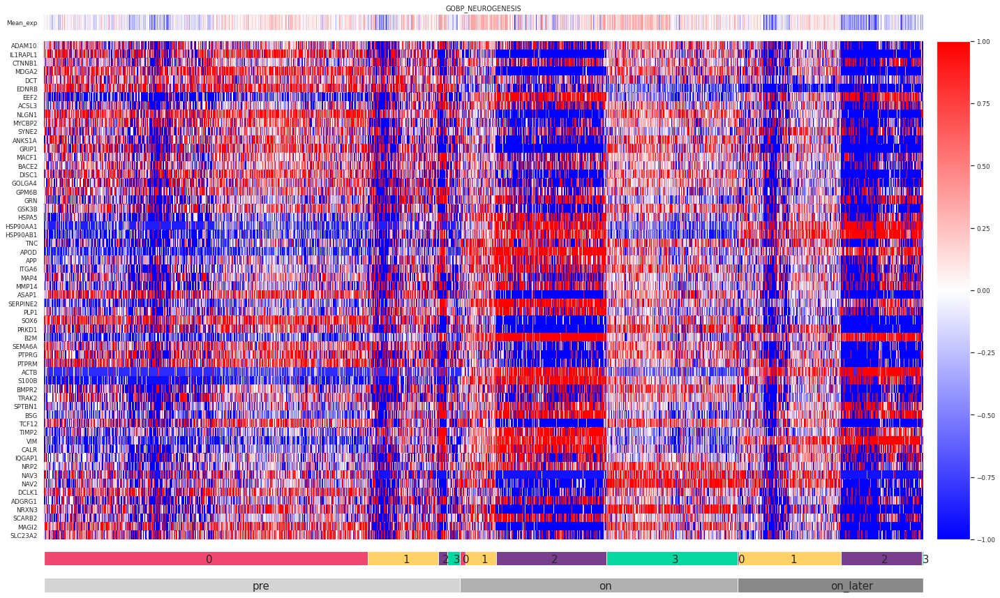

In [26]:
genes=full_heatmap(exh_sigs, 'GOBP_NEUROGENESIS',r310,vmax=1,thresh=300,mean_thresh=.55)

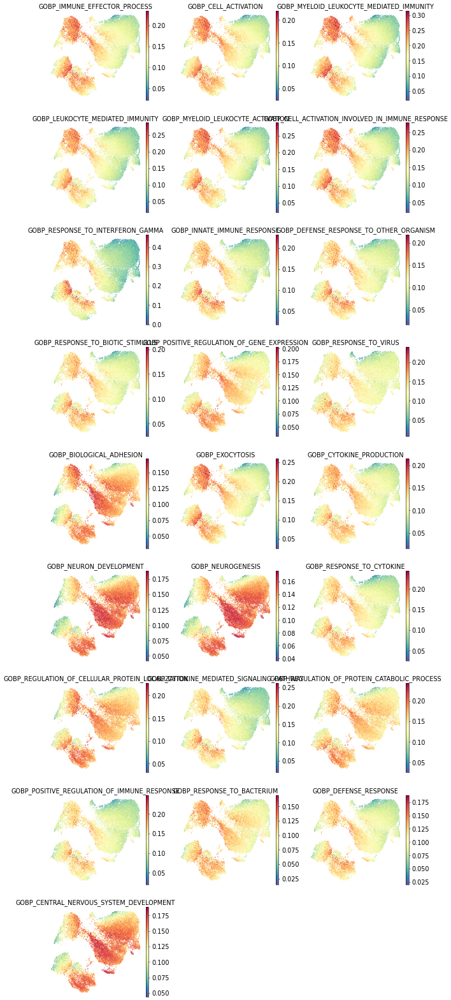

In [212]:
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(exh_sigs)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if sigs_np[i][j]!='NA':
            if sigs_np[i][j] in adata_df.columns:
                temp.append(adata_df[sigs_np[i][j]])
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=exh_sigs.index)

signatures_types=exh_sigs.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=exh_sigs.index,
    palette='tab20', color_map='Spectral_r', 
    s=10,
    ncols=3,
    save='r310supp3.pdf'
)

<ipython-input-104-81e087a2eb2b>:63: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20,12))


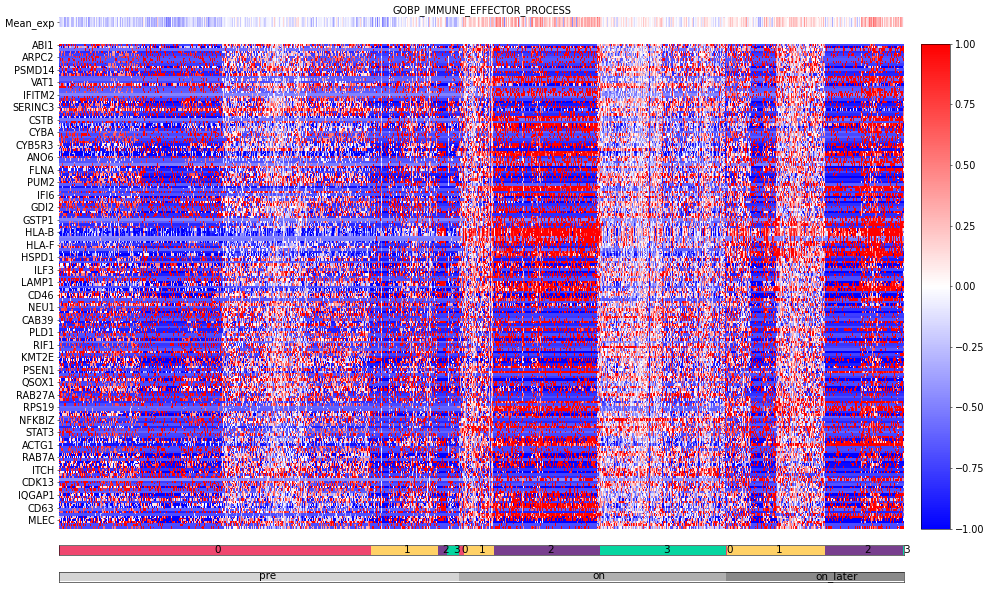

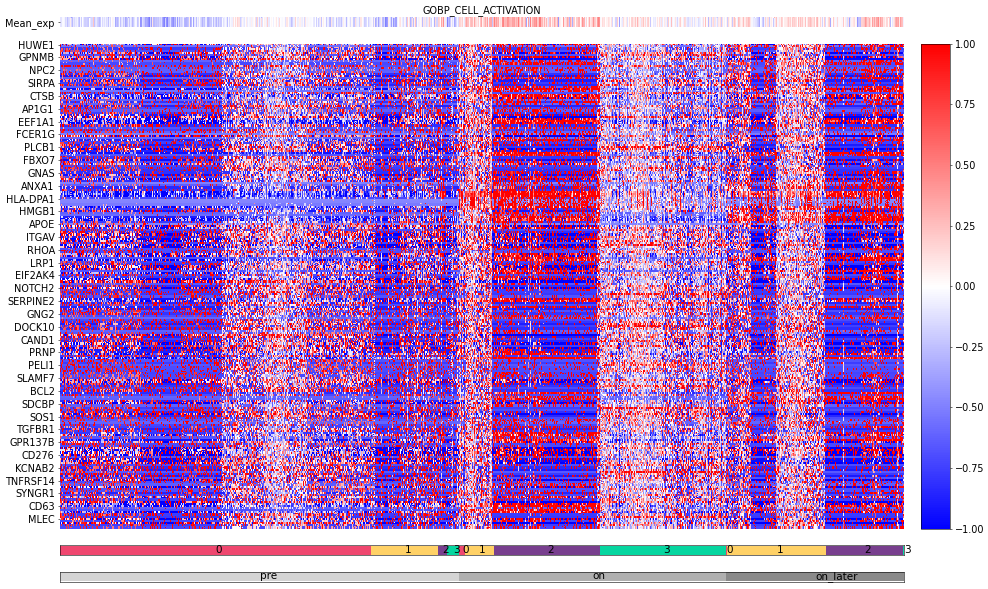

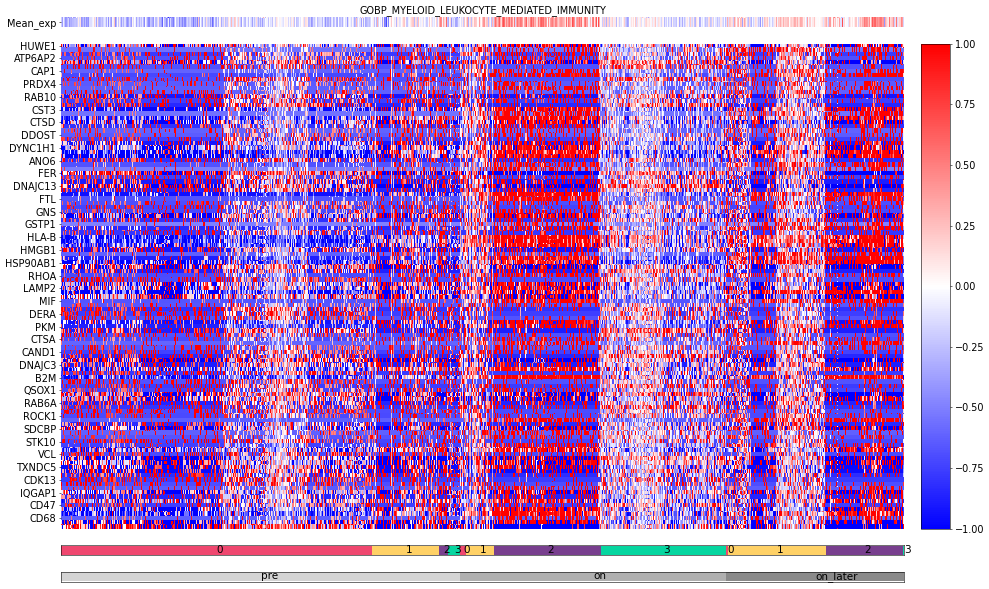

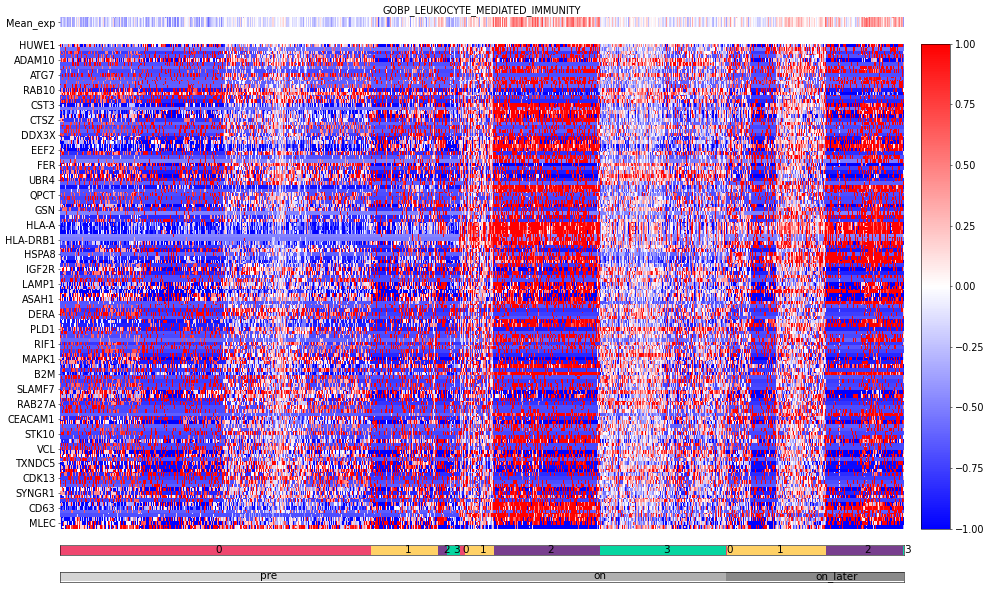

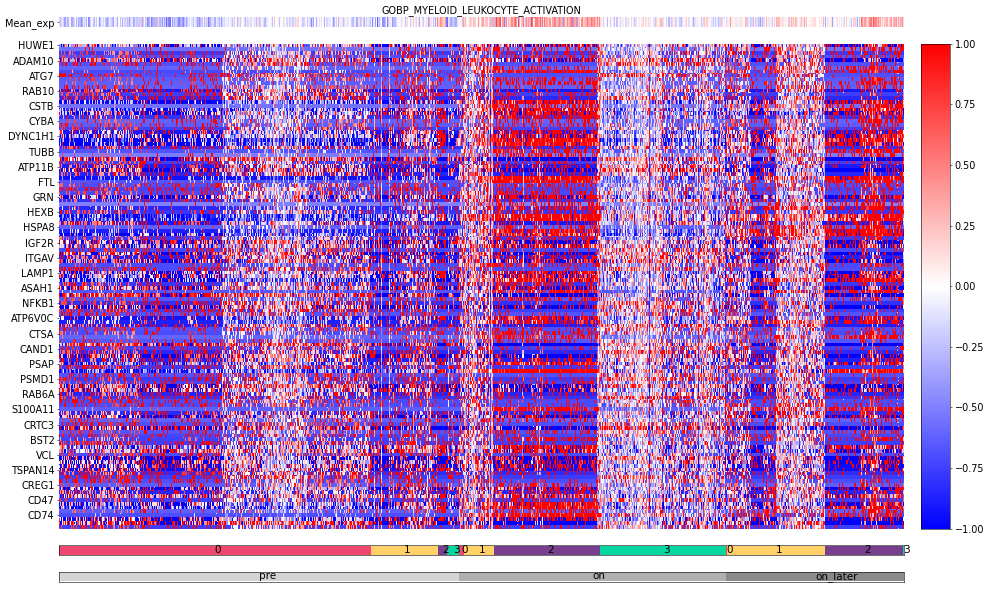

...

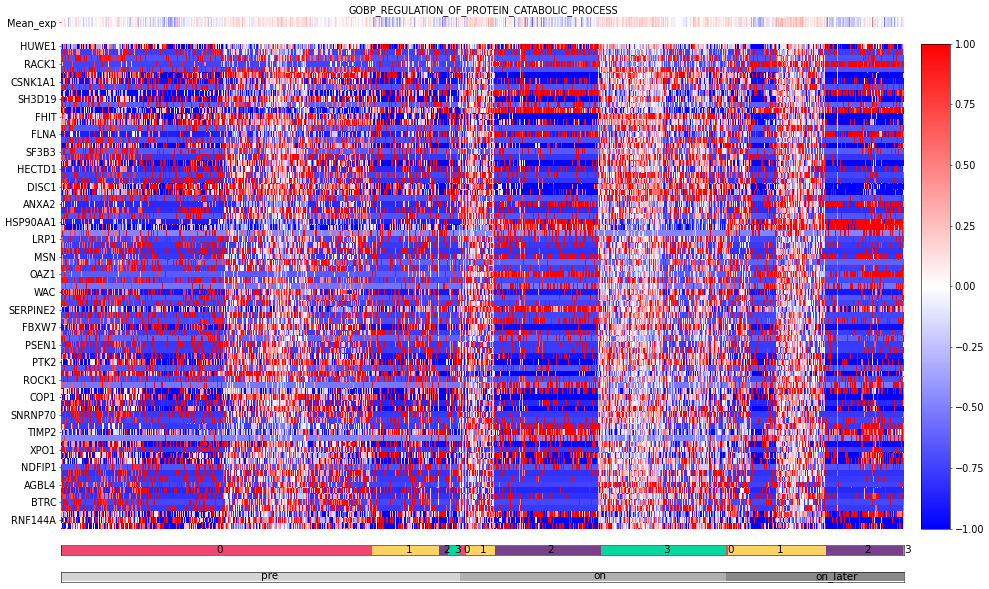

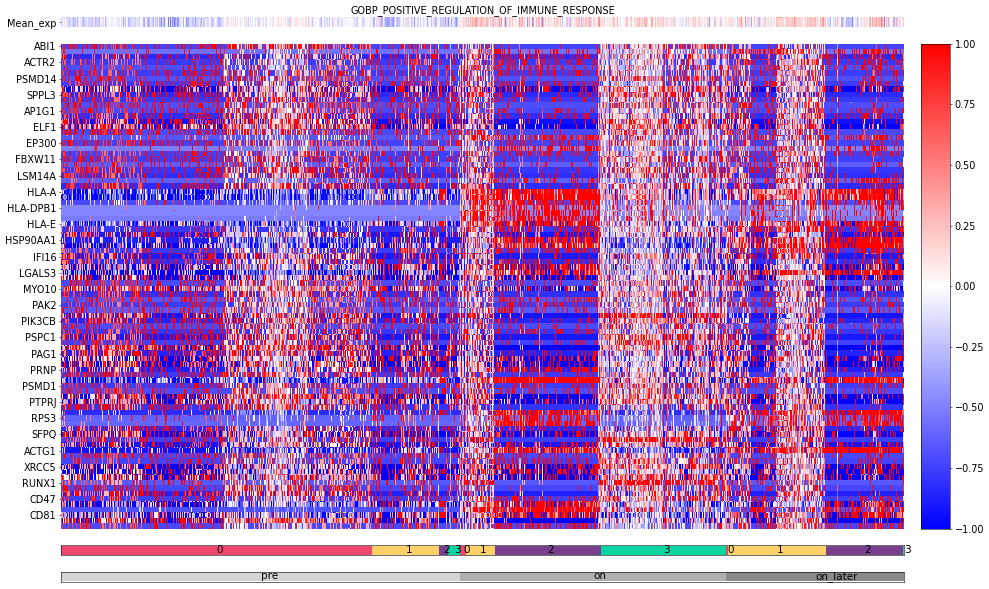

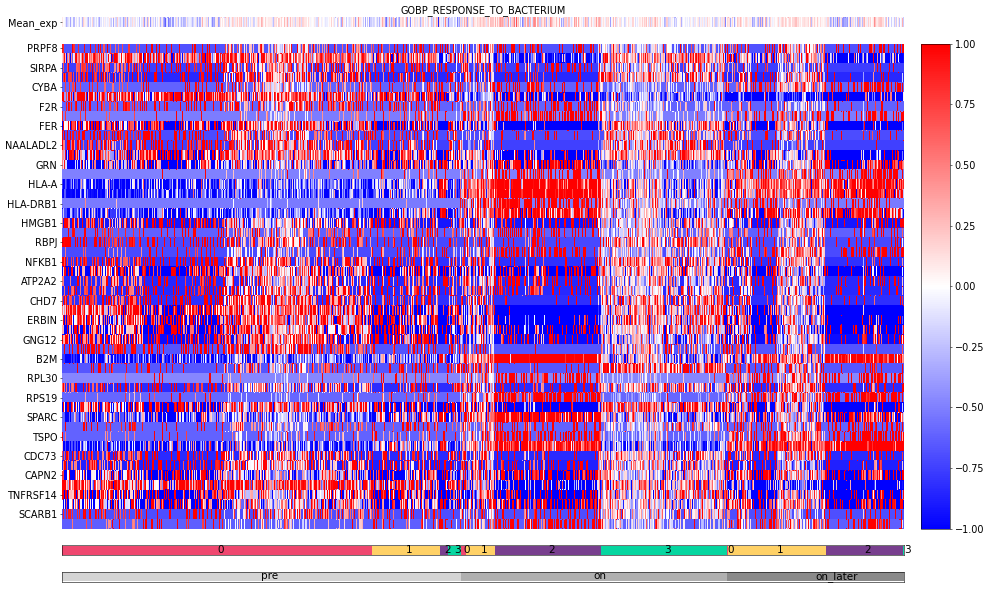

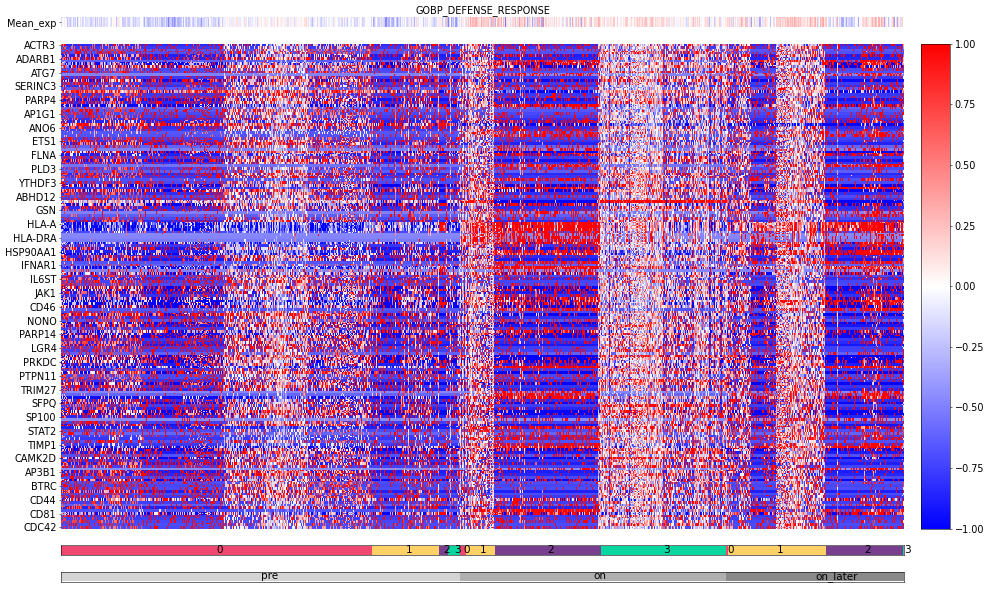

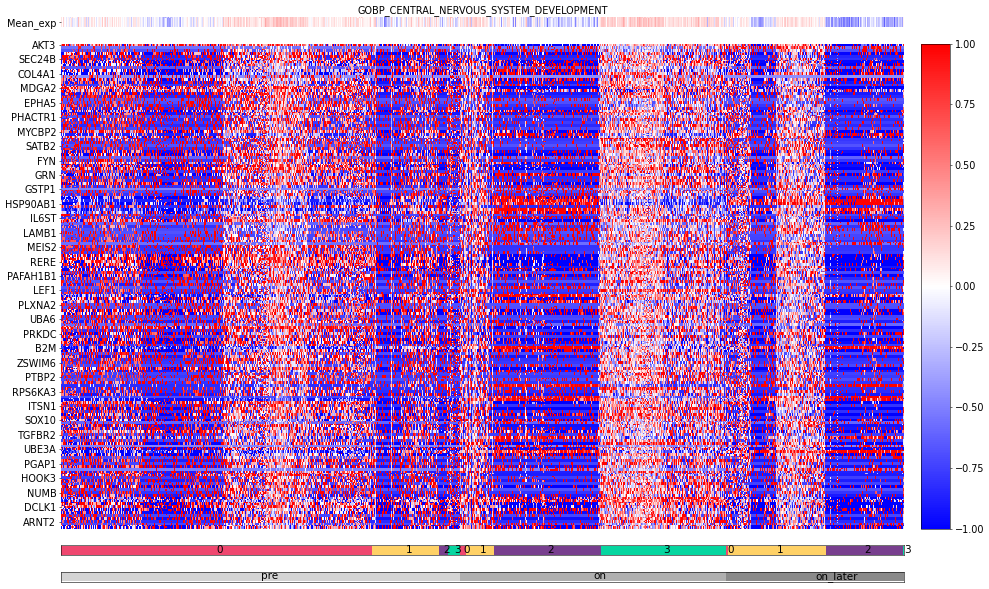

In [218]:
for i in interesting:
    genes=full_heatmap(exh_sigs, i,r310,vmax=1,thresh=300,mean_thresh=.2)

In [21]:
'ADAR1' in r310.var_names

False

In [10]:
sns.set(font_scale=1.4)

### CD4/CD8 Dynamics

In [112]:
r310.obs["CD8a/b"]=(r310.to_df()['CD8A']+r310.to_df()['CD8B'])/2

In [115]:
sc.pp.pca(r310, n_comps= 100)
communities, graph, Q = sc.external.tl.phenograph(pd.DataFrame(r310.obsm['X_pca']), k = 10)

r310.obs['PhenoGraph_clusters'] = pd.Categorical(communities)
r310.uns['PhenoGraph_Q'] = Q

Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 25.838744640350342 seconds
Jaccard graph constructed in 4.616508483886719 seconds
Wrote graph to binary file in 0.6384801864624023 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.883033
After 2 runs, maximum modularity is Q = 0.884607
Louvain completed 22 runs in 6.984568119049072 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 41.77396869659424 seconds


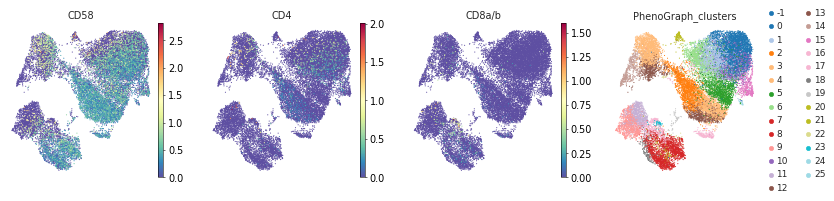

In [116]:
sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=["CD58","CD4","CD8a/b","PhenoGraph_clusters"],
    palette='tab20', color_map='Spectral_r', 
    s=10
)

In [126]:
cd4_mean={}
cd8_mean={}
for i in np.unique(r310.obs["PhenoGraph_clusters"]):
    tmp=subsample(r310,"PhenoGraph_clusters",[i])
    cd4_mean[i]=np.mean(tmp.to_df()["CD4"])
    cd8_mean[i]=np.mean(tmp.obs["CD8a/b"])

Text(0.5, 1.0, 'Cluster Means of CD4')

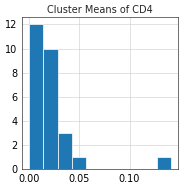

In [127]:
plt.hist(cd4_mean.values())
plt.title("Cluster Means of CD4")

Text(0.5, 1.0, 'Cluster Means of CD8')

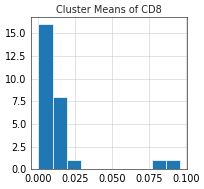

In [128]:
plt.hist(cd8_mean.values())
plt.title("Cluster Means of CD8")

In [138]:
cd4=[]
cd8=[]
for i in r310.obs["PhenoGraph_clusters"]:
    if cd4_mean[i]>.1:
        cd4.append('1')
    else:
        cd4.append('0')
    if cd8_mean[i]>.075:
        cd8.append('1')
    else:
        cd8.append('0')

In [139]:
r310.obs["CD4_binary"]=cd4
r310.obs["CD8_binary"]=cd8

In [140]:
binary=["grey",'red']

... storing 'CD4_binary' as categorical
... storing 'CD8_binary' as categorical


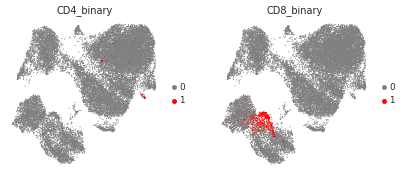

In [141]:
sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=["CD4_binary","CD8_binary"],
    palette=binary,
    s=10
)

In [146]:
pre_=subsample(r310,"treatment",["pre"])
pre_cd4=0
pre_cd8=0

for i in range(len(pre_.obs["CD4_binary"])):
    if pre_.obs["CD4_binary"][i]=="1":
        pre_cd4+=1
    if pre_.obs["CD8_binary"][i]=="1":
        pre_cd8+=1
pre_cd4=pre_cd4/len(pre_.obs["CD4_binary"])
pre_cd8=pre_cd8/len(pre_.obs["CD4_binary"])

on_=subsample(r310,"treatment",["on"])
on_cd4=0
on_cd8=0

for i in range(len(on_.obs["CD4_binary"])):
    if on_.obs["CD4_binary"][i]=="1":
        on_cd4+=1
    if on_.obs["CD8_binary"][i]=="1":
        on_cd8+=1
on_cd4=on_cd4/len(on_.obs["CD4_binary"])
on_cd8=on_cd8/len(on_.obs["CD4_binary"])

later_=subsample(r310,"treatment",["on_later"])
later_cd4=0
later_cd8=0

for i in range(len(later_.obs["CD4_binary"])):
    if later_.obs["CD4_binary"][i]=="1":
        later_cd4+=1
    if later_.obs["CD8_binary"][i]=="1":
        later_cd8+=1
later_cd4=later_cd4/len(later_.obs["CD4_binary"])
later_cd8=later_cd8/len(later_.obs["CD4_binary"])

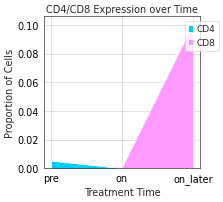

In [149]:
times = ["pre","on","on_later"]


fig, ax = plt.subplots()
ax.stackplot(times, [[pre_cd4,on_cd4,later_cd4],[pre_cd8,on_cd8,later_cd8]],
             labels=["CD4","CD8"],
             colors=["#00ccff","#ff99ff","#6600cc","#ff3399","#33cc33","#ffcccc","#666699","#0059b3","#990033","#ff9966"])
ax.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
ax.set_title('CD4/CD8 Expression over Time')
ax.set_xlabel('Treatment Time')
ax.set_ylabel('Proportion of Cells')

plt.show()

### DEGs for Interesting inferCNV Clones

In [3]:
r310.obs["inferCNV_clones"]=pd.Categorical(r310.obs["inferCNV_clones"])

In [11]:
ttest,scores=ttest_degs(r310,0,"inferCNV_clones")

In [12]:
ttest300=pd.concat((ttest[0:150],ttest[-150:]))

In [68]:
scores300=pd.concat((scores[0:150],scores[-150:]))

In [13]:
ttest

,Cluster 0,Cluster 1,Cluster 2,Cluster 3
0,INPP4B,FP236383.3,B2M,NEAT1
1,EGLN3,MALAT1,VIM,AC010967.1
2,STK32A,ZNF841,HLA-A,AC011246.1
3,RDX,FP671120.4,HLA-C,MALAT1
4,EDNRB,AC105052.4,S100A4,AC092546.1
...,...,...,...,...
21361,FTH1,AC024230.1,SMYD3,HSP90AB1
21362,WARS,FBXL7,LRMDA,TMSB10
21363,HLA-C,LINC02163,LINC02109,MIF
21364,S100A4,EDNRB,MIR3681HG,TPT1


In [14]:
signature=ttest["Cluster 2"][0:300]

In [69]:
c2=pd.DataFrame({"genes":ttest300["Cluster 2"], "score": scores300["Cluster 2"]})

In [42]:
c2=c2.loc[0:300]

In [70]:
c2.to_csv("c2.rnk",header=None,index=None,sep='\t')

In [83]:
c1=pd.DataFrame({"genes":ttest["Cluster 1"], "score": scores["Cluster 1"]})
c1.to_csv("c1.rnk",header=None,index=None,sep='\t')

In [16]:
signature=pd.DataFrame({"Imm Res (Clone 2)":signature}).T

In [17]:
signature

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
Imm Res (Clone 2),B2M,VIM,HLA-A,HLA-C,S100A4,HLA-B,FTH1,APOD,EEF1A1,CD63,...,GADD45GIP1,TRAPPC5,UBL5,RAB13,COX7C,RAN,SNRPD2,NDUFB10,NDUFB7,GABARAPL2


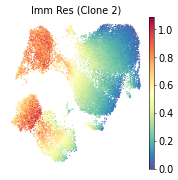

In [19]:
adata_df=r310.to_df()

#create cell signature markers by averaging expression for each cell across all gene markers
sigs_np=np.asarray(signature)
signatures=[]
for i in range(sigs_np.shape[0]):
    temp=[]
    for j in range(sigs_np.shape[1]):
        if sigs_np[i][j]!='NA':
            if sigs_np[i][j] in adata_df.columns:
                temp.append(adata_df[sigs_np[i][j]])
    if len(temp)==0:
        signatures.append([0 for k in range(adata_df.shape[0])])
    else:
        signatures.append(np.mean(temp,axis=0))    

signatures=np.asarray(signatures)

signatures=pd.DataFrame(np.transpose(signatures), columns=signature.index)

signatures_types=signature.index
signatures=np.asarray(signatures)
for i in range(signatures.shape[1]):
    r310.obs[signatures_types[i]]=signatures[:,i]

sc.set_figure_params(dpi=50, frameon = None)
sc.pl.umap(
    r310, 
    color=signature.index,
    palette='tab20', color_map='Spectral_r', 
    s=10,
    ncols=3
    #save='r310supp3.pdf'
)

### Evaluation of our Immune Resistance on Liu et al dataset

In [81]:
liu=pd.read_csv("Liu_NatMed_41591_2019_654_MOESM3_ESM.txt",sep='\t',index_col=0)

In [39]:
sigs_in_liu=[i for i in signature.loc["Imm Res (Clone 2)"] if i in liu.columns]


In [82]:
liu_signatures=liu[sigs_in_liu]

In [83]:
liu_signatures

,B2M,VIM,HLA-A,HLA-C,S100A4,HLA-B,FTH1,APOD,EEF1A1,CD63,...,GADD45GIP1,TRAPPC5,UBL5,RAB13,COX7C,RAN,SNRPD2,NDUFB10,NDUFB7,GABARAPL2
Patient100,10999.244456,2013.476655,1470.733880,1194.287418,110.789680,2033.724182,3359.171945,79.424485,2339.460072,1162.728719,...,20.124388,28.304318,205.078769,75.308133,113.780192,181.770366,114.149608,66.846742,31.857750,59.739878
Patient102,3715.760109,4332.263277,219.394085,331.395055,185.749800,150.484661,3980.978035,1552.684937,4434.840142,2606.355422,...,31.120385,16.509550,349.919094,271.238239,242.016568,178.710665,111.885195,57.910776,43.392561,64.162640
Patient105,1695.167746,1674.125888,144.074518,122.167186,26.369937,113.512437,8922.180341,285.119874,7039.880703,1240.117291,...,9.195670,7.897458,258.695845,80.218701,430.708974,209.120363,78.974581,32.103708,18.093834,37.323603
Patient106,6433.224485,2193.194382,863.280914,846.461902,27.342772,832.160991,4625.822124,249.885854,5138.469403,2990.600833,...,28.079198,31.309968,291.885872,120.037382,460.931194,352.462821,181.517046,108.990997,40.289610,91.435560
Patient107,3095.023670,10368.266795,112.224011,184.108285,0.000000,223.720770,4030.701017,6708.986800,11722.068352,5354.935251,...,11.840565,0.000000,50.066726,87.020198,115.860269,402.033768,322.876978,0.000000,26.181057,101.837949
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Patient196,747.111059,2750.650772,1240.971982,208.655420,8.587040,275.306286,4380.856868,713.264615,3759.772678,2957.222146,...,37.995239,42.645748,410.614878,179.536671,503.856623,455.614826,175.928185,132.742128,65.975481,60.032092
Patient197,879.581412,5524.843858,191.865012,56.891138,7.303998,49.106877,9044.550263,518.183612,5092.407176,3765.821109,...,55.430338,46.025191,416.648040,115.663305,221.901451,267.926642,200.489732,119.265276,109.439899,46.685552
Patient204,5307.343447,1829.540417,1491.046023,974.160059,124.413411,1616.930303,1143.448885,222.906205,2455.659302,932.947943,...,22.784611,37.992853,236.810090,82.757259,272.971293,249.631637,136.013858,105.181090,36.466478,76.818274
Patient205,10171.951993,7221.954371,3370.708740,2049.882288,576.041893,1838.484155,3148.138323,170.441676,1450.311669,2025.040691,...,36.914871,34.623781,342.479392,85.130739,190.829805,284.507083,144.853543,98.130746,66.029738,82.736678


In [73]:
zscr=pd.DataFrame()
for i in liu_signatures.columns:
    zscr[i]=stats.zscore(liu_signatures[i])

In [74]:
#zscr=zscr.T

In [75]:
zscr.index=liu_signatures.index
zscr

,B2M,VIM,HLA-A,HLA-C,S100A4,HLA-B,FTH1,APOD,EEF1A1,CD63,...,GADD45GIP1,TRAPPC5,UBL5,RAB13,COX7C,RAN,SNRPD2,NDUFB10,NDUFB7,GABARAPL2
Patient100,1.733966,-0.762729,1.779528,2.142059,-0.044232,2.726060,-0.370608,-0.538122,-0.956071,-0.731586,...,-0.315473,-0.128927,-0.858832,-0.414095,-1.134591,-0.832797,-0.400016,-0.416705,-0.583014,-0.319916
Patient102,-0.275524,0.496768,-0.637842,-0.186370,0.236621,-0.796955,-0.143660,0.668859,0.010333,0.213162,...,0.594497,-0.656517,0.455647,3.778365,-0.656334,-0.861856,-0.438240,-0.634420,-0.022781,-0.147736
Patient105,-0.832999,-0.947054,-0.783346,-0.750951,-0.360526,-0.866120,1.659789,-0.369605,1.211794,-0.680941,...,-1.219875,-1.041742,-0.372237,-0.309020,0.047394,-0.573045,-0.993780,-1.263182,-1.251511,-1.192591
Patient106,0.474216,-0.665112,0.606035,1.203486,-0.356881,0.478271,0.091696,-0.398470,0.334851,0.464622,...,0.342825,0.005518,-0.071025,0.543009,0.160108,0.788323,0.737166,0.610094,-0.173488,0.914009
Patient107,-0.446783,3.775348,-0.844876,-0.583809,-0.459326,-0.659951,-0.125512,4.893202,3.371250,2.011906,...,-1.000998,-1.395002,-2.265623,-0.163484,-1.126834,1.259114,3.123363,-2.045354,-0.858724,1.318978
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Patient196,-1.094565,-0.362318,1.335668,-0.517571,-0.427153,-0.563449,0.002288,-0.018844,-0.301013,0.442779,...,1.163424,0.512577,1.006484,1.816159,0.320198,1.767990,0.642825,1.188765,1.074045,-0.308540
Patient197,-1.058017,1.144543,-0.691023,-0.927091,-0.431960,-0.986605,1.704452,-0.178665,0.313607,0.971947,...,2.606260,0.663742,1.061237,0.449414,-0.731353,-0.014544,1.057431,0.860416,3.185062,-0.828126
Patient204,0.163589,-0.862638,1.818768,1.548067,0.006812,1.946355,-1.179307,-0.420574,-0.902479,-0.881961,...,-0.095327,0.304449,-0.570858,-0.254701,-0.540888,-0.188297,-0.030941,0.517270,-0.359173,0.344952
Patient205,1.505719,2.066364,5.449949,4.450796,1.698924,2.360821,-0.447632,-0.463556,-1.366152,-0.167266,...,1.074018,0.153747,0.388129,-0.203914,-0.847235,0.142926,0.118276,0.345496,1.076681,0.575358


<AxesSubplot:>

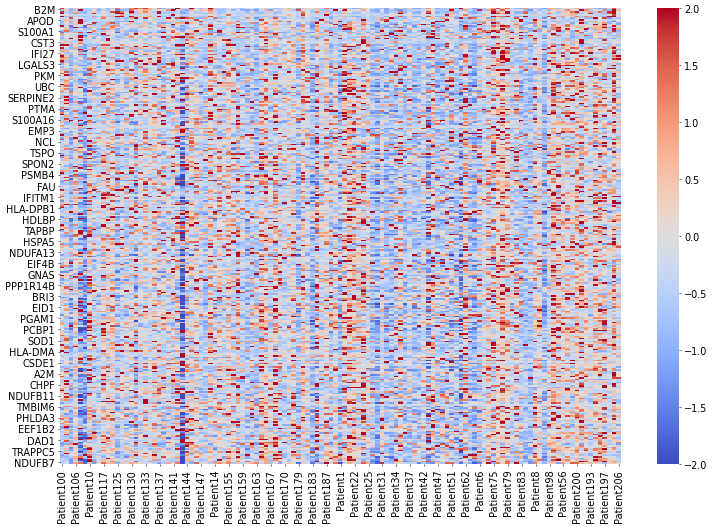

In [77]:
fig=plt.figure(figsize=(18,12))
sns.heatmap(zscr.T,vmin=-2,vmax=2,cmap='coolwarm')

<AxesSubplot:>

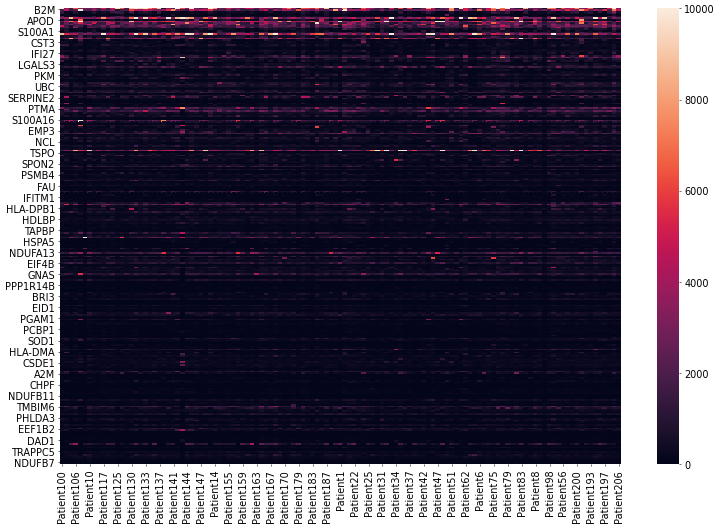

In [86]:
fig=plt.figure(figsize=(18,12))
sns.heatmap(liu_signatures.T,vmax=10000)

In [92]:
meta=pd.read_csv("Liu_NatMed_41591_2019_654_MOESM4_ESM.csv",index_col=0)

In [148]:
print(meta.columns)

Index(['total_muts', 'nonsyn_muts', 'clonal_muts', 'subclonal_muts',
       'heterogeneity', 'total_neoantigens', 'CNA_prop',
       'gender (Male=1, Female=0)', 'biopsy site', 'monthsBiopsyPreTx', 'BR',
       'PFS', 'OS', 'TimeToBR', 'cyclesOnTherapy', 'txOngoing', 'Tx',
       'Mstage (IIIC=0, M1a=1, M1b=2, M1c=3)', 'Tx_Start_ECOG', 'Tx_Start_LDH',
       'LDH_Elevated', 'Brain_Met', 'Cut_SubQ_Met', 'LN_Met', 'Lung_Met',
       'Liver_Visc_Met', 'Bone_Met', 'progressed', 'dead', 'Primary_Type',
       'Histology', 'IOTherapy', 'steroidsGT10mgDaily', 'priorMAPKTx',
       'priorCTLA4', 'postCTLA4', 'postMAPKTx', 'postCombinedCTLA_PD1',
       'numPriorTherapies', 'biopsy site_categ',
       'biopsyContext (1=Pre-Ipi; 2=On-Ipi; 3=Pre-PD1; 4=On-PD1)',
       'daysBiopsyToPD1', 'daysBiopsyAfterIpiStart', 'purity', 'ploidy'],
      dtype='object')


In [111]:
drop=[]
for i in meta.sort_values(by="total_muts").index:
    if i not in liu_signatures.T.columns:
        drop.append(i)
meta=meta.drop(drop)

In [ ]:
liu_plot("Primary_Type")

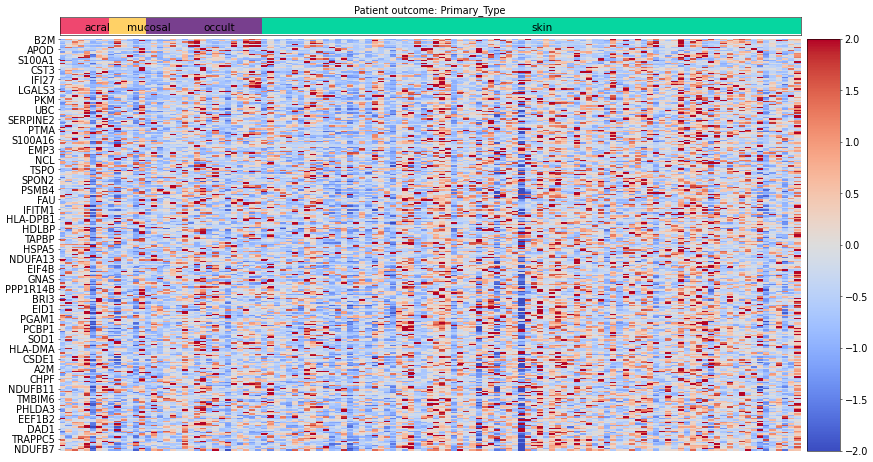

In [154]:
liu_plot("Primary_Type")

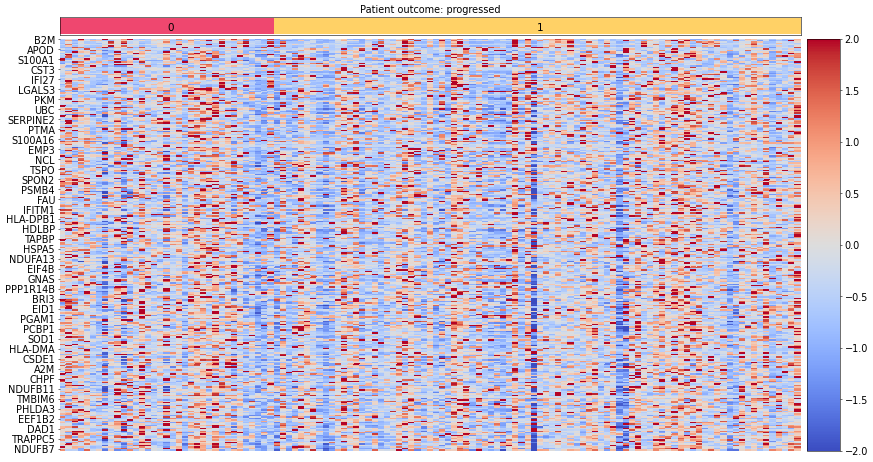

In [149]:
liu_plot("progressed")

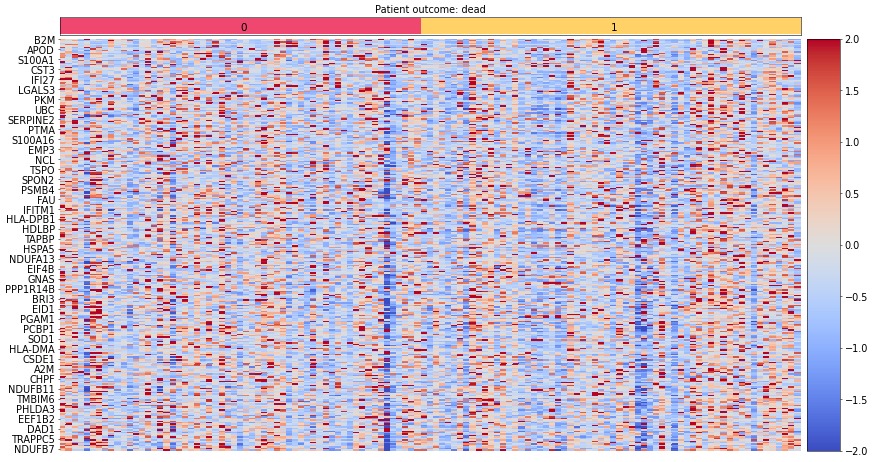

In [147]:
liu_plot("dead")

In [ ]:
liu_plot("dead")

In [153]:
def liu_plot(outcome):    
    coords,labels=get_coords(meta.sort_values(by=outcome)[outcome])

    fig = plt.figure(figsize=(20,12))
    ax1 = plt.subplot2grid((21,20), (2,0), colspan=19, rowspan=19)
    ax2 = plt.subplot2grid((21,20), (1,0), colspan=19, rowspan=1,sharex = ax1)
    ax3 = plt.subplot2grid((21,20), (2,19), colspan=1, rowspan=19)


    #ax1.set_xticks([i for i in range(len(zscr.index))])
    sns.heatmap(zscr.T[meta.sort_values(by=outcome).index],ax=ax1,vmin=-2,vmax=2,cmap='coolwarm',cbar=False)

    txt=labels
    colors=[palette[i] for i in range(len(labels))]
    for i in range(len(txt)):
        ax2.barh([-0.15], coords[i+1]-coords[i], left=coords[i], height=1.2, color=colors[i])
        ax2.text((coords[i]+coords[i+1])/2, -0.5, txt[i],fontsize=15 )
    ax2.set_yticks([])  
    ax2.set_xticks([]) 
    ax2.set_title("Patient outcome: "+outcome)

    cmap = mpl.cm.coolwarm
    #norm = mpl.colors.Normalize(vmin=np.min(np.asarray(heatmap)), vmax=vmax)
    norm = mpl.colors.Normalize(vmin=-2, vmax=2)
    #norm = mpl.colors.Normalize(vmin=-2, vmax=2)
    cb1 = mpl.colorbar.ColorbarBase(ax3, cmap=cmap,
                                    norm=norm,
                                    orientation='vertical')

In [42]:
liu_signatures_avg=np.mean(liu_signatures,axis=1)

In [43]:
liu_signatures_avg

Patient100    453.283487
Patient102    486.501592
Patient105    354.825602
Patient106    472.431155
Patient107    563.769708
                 ...    
Patient196    443.574608
Patient197    489.213777
Patient204    349.571966
Patient205    575.414273
Patient206    400.018707
Length: 121, dtype: float64

In [31]:
patient_sig_avg

[nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan,
 nan]

In [25]:
pd.read_csv("TCGA_SKCM/TCGA_COUNTS.csv")

,Unnamed: 0,TCGA-3N-A9WB-06,TCGA-3N-A9WC-06,TCGA-3N-A9WD-06,TCGA-BF-A1PU-01,TCGA-BF-A1PV-01,TCGA-BF-A1PX-01,TCGA-BF-A1PZ-01,TCGA-BF-A1Q0-01,TCGA-BF-A3DJ-01,...,TCGA-XV-AB01-01,TCGA-YD-A89C-06,TCGA-YD-A9TA-06,TCGA-YD-A9TB-06,TCGA-YG-AA3N-01,TCGA-YG-AA3O-06,TCGA-YG-AA3P-06,TCGA-Z2-A8RT-06,TCGA-Z2-AA3S-06,TCGA-Z2-AA3V-06
0,1,381.0,195.0,361.0,176.0,217.0,285.0,425.0,328.0,232.0,...,429.0,185.0,88.0,265.0,239.0,208.0,34.0,336.0,349.0,717.0
1,29974,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,87769,250.0,161.0,97.0,163.0,61.0,126.0,79.0,68.0,93.0,...,48.0,102.0,37.0,146.0,88.0,86.0,50.0,37.0,153.0,51.0
3,144568,7.0,0.0,0.0,8.0,1.0,3277.0,27.0,6.0,985.0,...,0.0,0.0,0.0,0.0,1701.0,0.0,0.0,0.0,0.0,0.0
4,2,2210.0,169237.0,18258.0,6716.0,1741.0,32098.0,3219.0,6469.0,377756.0,...,17450.0,20640.0,12397.0,25478.0,10301.0,37320.0,8217.0,22130.0,4040.0,46111.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23879,317702,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23880,653440,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23881,7617,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23882,285346,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Clonal Expansion Visualizations

In [124]:
palette=["#EF476F","#FFD166","#783F8E","#06D6A0"]

In [16]:
randomize=np.arange(len(r310.obs["treatment"]))
np.random.shuffle(randomize)

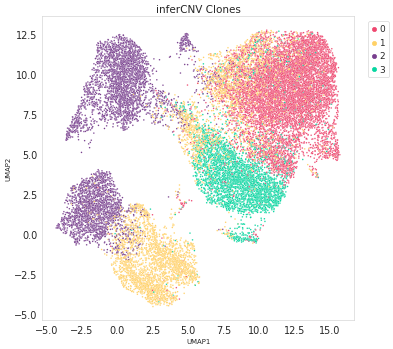

In [43]:
import seaborn as sns
fig, ax = plt.subplots(figsize=(8,8))
sns.set_style("whitegrid", {'axes.grid' : False})
scatter=sns.scatterplot(x=r310.obsm["X_umap"][:,0][randomize],y=r310.obsm["X_umap"][:,1][randomize], hue=r310.obs["inferCNV_clones"][randomize],s=5,palette=palette)
scatter.legend(bbox_to_anchor= (1.03, 1) );
scatter.set_xlabel("UMAP1", fontsize = 10)
scatter.set_ylabel("UMAP2", fontsize = 10)
scatter.set_title("inferCNV Clones", fontsize = 15)
plt.savefig("figures/2d_1.pdf",format='pdf')

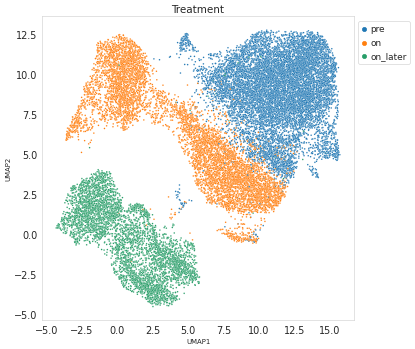

In [42]:
import seaborn as sns
fig, ax = plt.subplots(figsize=(8,8))
sns.set_style("whitegrid", {'axes.grid' : False})
scatter=sns.scatterplot(x=r310.obsm["X_umap"][:,0][randomize],y=r310.obsm["X_umap"][:,1][randomize], ax=ax,hue=r310.obs["treatment"][randomize],s=5,hue_order=["pre","on","on_later"])
scatter.legend(bbox_to_anchor= (1, 1) );
scatter.set_xlabel("UMAP1", fontsize = 10)
scatter.set_ylabel("UMAP2", fontsize = 10)
scatter.set_title("Treatment", fontsize = 15)
plt.savefig("figures/2c.pdf",format='pdf')

In [42]:
r310

AnnData object with n_obs × n_vars = 21073 × 21558
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'patient', 'ScrubDoublet', 'ScrubDoublet_score', 'RNA_snn_res.0.8', 'seurat_clusters', 'celltype_bped_main', 'celltype_bped_fine', 'celltype_iced_main', 'celltype_iced_fine', 'celltype_hpca_main', 'celltype_hpca_fine', 'celltype_mid_main', 'celltype_mid_fine', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'original_total_counts', 'log10_original_total_counts', 'n_counts', 'treatment', 'Myeloid', 'NK', 'Macrophage', 'Monocyte', 'B Cells', 'HSCs', 'T cells', 'T_regs', 'prolif', 'endothelial', 'fibroblast', 'erythroid', 'Th17', 'Th22', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'Diffusion component 0', 'Diffusion component 1', 'Diffusion component 2', 'Diffusion component 3

In [25]:
label=[str(i) for i in range(4)]
treatment=r310.obs['treatment']
clonality=r310.obs['inferCNV_clones']

In [26]:
#create dict of pre source nodes
pre_clones={}
for i in range(len(treatment)):
    if treatment[i]=='pre':
        if clonality[i]!=-1:
            if clonality[i] in pre_clones:
                #pre_clones[clonality[i]]=pre_clones[clonality[i]]+[r310.obs_names[i]]
                pre_clones[clonality[i]]=pre_clones[clonality[i]]+1
            else:
                #pre_clones[clonality[i]]=[r310.obs_names[i]]
                pre_clones[clonality[i]]=1


In [27]:
#create dict of on source nodes
on_clones={}
for i in range(len(treatment)):
    if treatment[i]=='on':
        if clonality[i]!=-1:
            if clonality[i] in on_clones:
                on_clones[clonality[i]]=on_clones[clonality[i]]+1
            else:
                on_clones[clonality[i]]=1


In [28]:
#create dict of on later nodes
later_clones={}
for i in range(len(treatment)):
    if treatment[i]=='on_later':
        if clonality[i]!=-1:
            if clonality[i] in later_clones:
                later_clones[clonality[i]]=later_clones[clonality[i]]+1
            else:
                later_clones[clonality[i]]=1

In [29]:
clone_by_time={}
for i in range(4):
    if i in pre_clones:
        clone_by_time[str(i)]=[pre_clones[i]/np.sum(list(pre_clones.values()))]
    else:
        clone_by_time[str(i)]=[0]
        
    if i in on_clones:
        clone_by_time[str(i)]=clone_by_time[str(i)]+[on_clones[i]/np.sum(list(on_clones.values()))]
    else:
        clone_by_time[str(i)]=clone_by_time[str(i)]+[0]
        
    if i in later_clones:
        clone_by_time[str(i)]=clone_by_time[str(i)]+[later_clones[i]/np.sum(list(later_clones.values()))]
    else:
        clone_by_time[str(i)]=clone_by_time[str(i)]+[0]

In [30]:
clone_by_time

{'0': [0.7781453634085213, 0.01969628627274094, 0.006296379581740499],
 '1': [0.16852130325814535, 0.1088558111562171, 0.5516078255003373],
 '2': [0.02175438596491228, 0.39933844534656443, 0.43512480323813807],
 '3': [0.031578947368421054, 0.4721094572244775, 0.006970991679784124]}

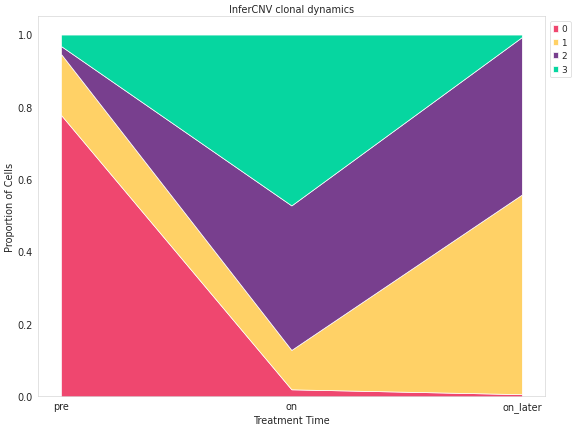

In [41]:
times = ["pre","on","on_later"]


fig, ax = plt.subplots(figsize=(13,10))
ax.stackplot(times, clone_by_time.values(),
             labels=clone_by_time.keys(),
             colors=palette)
ax.legend(loc='upper right', bbox_to_anchor=(1.06, 1))
ax.set_title('InferCNV clonal dynamics')
ax.set_xlabel('Treatment Time')
ax.set_ylabel('Proportion of Cells')

plt.savefig("figures/2d_2.pdf",format='pdf')

plt.show()

In [76]:
r310.X

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.04325173, 0.        ,
        0.        ],
       [0.        , 0.043557  , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]], dtype=float32)

### CD58 Violin Plot Analysis

Text(0.5, 0.98, 'CD58 Expression')

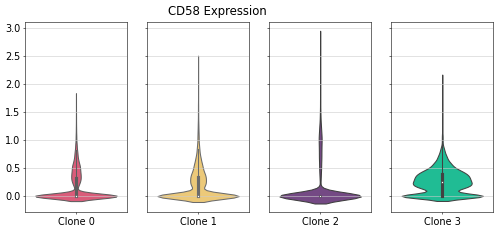

In [102]:
r310_df=r310.to_df()
fig, axs = plt.subplots(1, 4, figsize=(12,5),sharey=True)
for i in range(4):
    clone=subsample(r310,"inferCNV_clones",[i])
    df=pd.DataFrame({"Clone "+str(i):clone.to_df()["CD58"]})
    sns.violinplot(data=df,ax=axs[i],color=palette[i])
plt.suptitle("CD58 Expression")


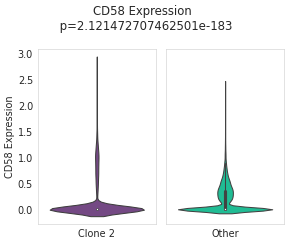

In [58]:
r310_df=r310.to_df()
fig, axs = plt.subplots(1, 2, figsize=(6,5),sharey=True)

clone=subsample(r310,"inferCNV_clones",[2])
df_2=pd.DataFrame({"Clone "+str(2):clone.to_df()["CD58"]})
sns.violinplot(data=df_2,ax=axs[0],color=palette[2])
axs[0].set_ylabel("CD58 Expression")
clone=subsample(r310,"inferCNV_clones",[0,1,3])
df_other=pd.DataFrame({"Other":clone.to_df()["CD58"]})
sns.violinplot(data=df_other,ax=axs[1],color=palette[3])

plt.suptitle("CD58 Expression \n p="+str(p))
plt.tight_layout()

plt.savefig("figures/2g.pdf",format='pdf')

In [51]:
import scipy
stat,p=scipy.stats.mannwhitneyu(df_2["Clone 2"],df_other["Other"])

Text(0.5, 0.98, 'Expression of Antigen Presentation Markers')

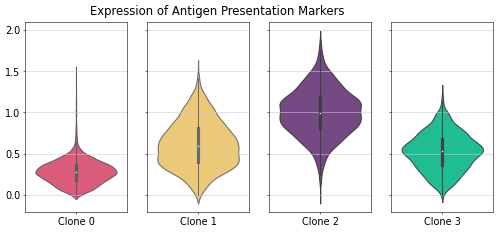

In [103]:
r310.obs["Antigen presentation"]

r310_df=r310.to_df()
fig, axs = plt.subplots(1, 4, figsize=(12,5),sharey=True)
for i in range(4):
    clone=subsample(r310,"inferCNV_clones",[i])
    df=pd.DataFrame({"Clone "+str(i):clone.obs["Antigen presentation"]})
    sns.violinplot(data=df,ax=axs[i],color=palette[i])
plt.suptitle("Expression of Antigen Presentation Markers")

### TCR Gini Analysis

In [4]:
pre_tcr=pd.read_csv("ribas_tcr/ribas1_pre_tcr_S35_L004_TR_frequency.csv")
on_tcr=pd.read_csv("ribas_tcr/ribas1_on_tcr_S36_L004_TR_frequency.csv")
later_tcr=pd.read_csv("ribas_tcr/ribas_310_on_later_previd_3_TCR_TR_frequency.csv")

In [5]:
pre_tcr

,TRA,TRB,constant,occurrences,barcodes
0,TRAV19_TRAJ11,TRBV2_TRBJ2-1,TRBC2,48,AACTGGTTCCGCAGTG-1|AACTGGTTCCGCAGTG-1|ACACCGGC...
1,TRAV19_TRAJ11,TRBV2_TRBJ2-1,TRAC,48,AACTGGTTCCGCAGTG-1|AACTGGTTCCGCAGTG-1|ACACCGGC...
2,TRAV26-1_TRAJ57,TRBV20-1_TRBD1_TRBJ2-6,TRBC2,3,CTAAGACTCTGTCTCG-1|TAAGAGAGTAGCGCTC-1|TAAGAGAG...
3,TRAV26-1_TRAJ57,TRBV20-1_TRBD1_TRBJ2-6,TRAC,3,CTAAGACTCTGTCTCG-1|TAAGAGAGTAGCGCTC-1|TAAGAGAG...
4,TRAV16_TRAJ37,TRBV5-1_TRBJ1-1,TRBC1,2,ATAACGCCAAACAACA-1|TTGTAGGCAGGATCGA-1|TTGTAGGC...
...,...,...,...,...,...
61,TRAV12-2_TRAJ40,TRBV12-3_TRBJ2-1,TRAC,1,AGCATACAGTCGATAA-1|AGCATACAGTCGATAA-1
62,TRAV9-2_TRAJ42,TRBV4-1_TRBJ2-1,TRBC2,1,CTGCTGTGTCTTGTCC-1|CTGCTGTGTCTTGTCC-1
63,TRAV9-2_TRAJ42,TRBV4-1_TRBJ2-1,TRAC,1,CTGCTGTGTCTTGTCC-1|CTGCTGTGTCTTGTCC-1
64,TRAV12-3_TRAJ23,TRBV19_TRBD1_TRBJ2-5,TRBC2,1,ACGTCAACACGGACAA-1|ACGTCAACACGGACAA-1


In [6]:
gini_simul=[]
for i in range(len(pre_tcr['occurrences'])):
    gini_simul+=[float(i) for j in range(pre_tcr['occurrences'][i])]
gini_simul=np.asarray(gini_simul)

In [7]:
gini(gini_simul)

0.7025628830197882

In [35]:
gini_simul=[]
for i in range(len(on_tcr['occurrences'])):
    gini_simul+=[float(i) for j in range(on_tcr['occurrences'][i])]
gini_simul=np.asarray(gini_simul)

In [36]:
gini(gini_simul)

0.6957874739442089

In [37]:
gini_simul=[]
for i in range(len(later_tcr['occurrences'])):
    gini_simul+=[float(i) for j in range(later_tcr['occurrences'][i])]
gini_simul=np.asarray(gini_simul)

In [38]:
gini(gini_simul)

0.7639207046849186

### InferCNV Regressions

In [11]:
clone=subsample(r310,"inferCNV_clones",[2])

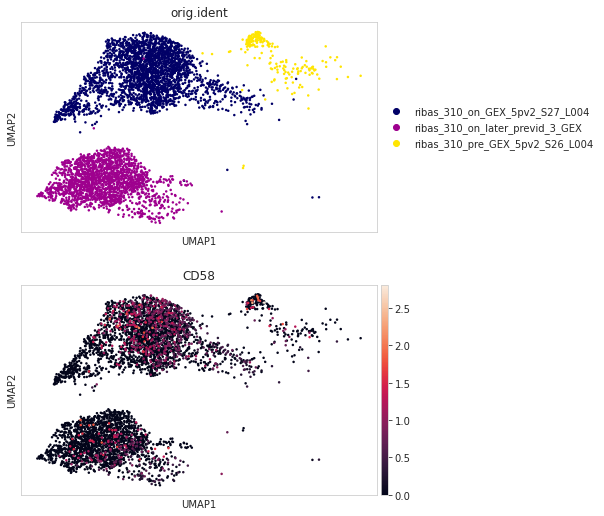

In [12]:
sc.pl.umap(clone,color=["orig.ident","CD58"],ncols=1)

In [32]:
sc.pp.neighbors(clone,n_neighbors=50)

In [ ]:
sc.tl.diffmap(clone)
for i in range(clone.obsm["X_diffmap"].shape[1]):
    clone.obs["Diffusion component "+str(i)]=stats.zscore(clone.obsm["X_diffmap"][:,i])

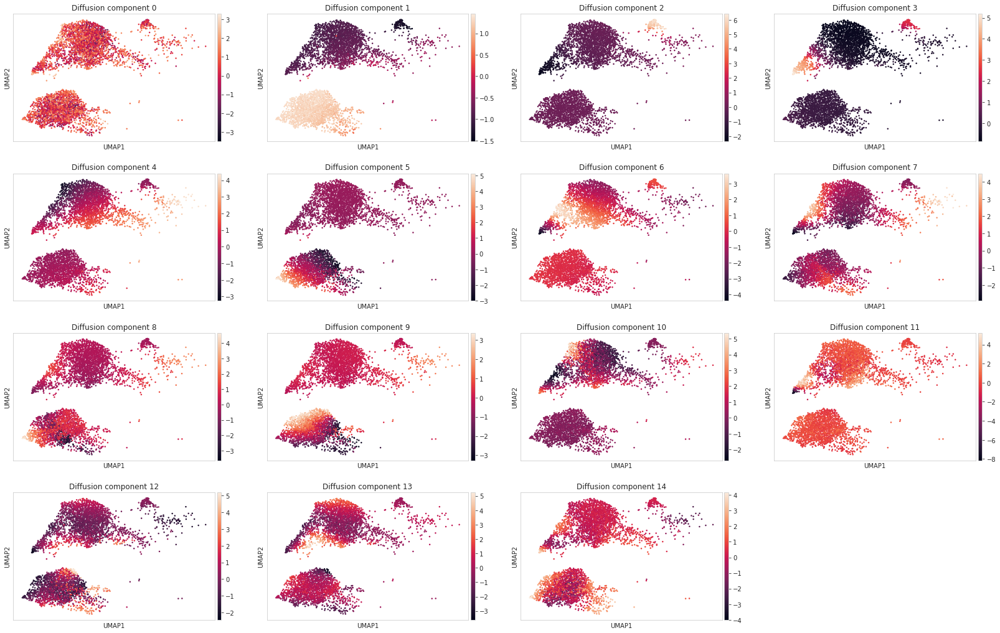

In [34]:
clone.obs["Diffusion component 1"]=-1*clone.obs["Diffusion component 1"]
sc.pl.umap(clone, color=["Diffusion component "+str(i) for i in range(clone.obsm["X_diffmap"].shape[1])])

In [26]:
from scipy import stats
zscore=stats.zscore(clone.obs["Diffusion component 4"])

In [30]:
clone.obs["2/4"]=(clone.obs["Diffusion component 2"]+clone.obs["Diffusion component 4"])/2

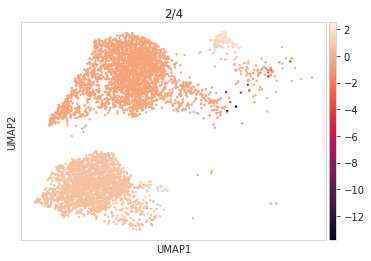

In [31]:
sc.pl.umap(clone,color="2/4")

In [13]:
r310=clone

In [6]:
on=pd.read_csv("ribas_final/inferCNV_ribas_310_on_GEX_5pv2",index_col=0)
on=np.transpose(on)

on_later=pd.read_csv("ribas_final/inferCNV_ribas_310_on_later",index_col=0)
on_later=np.transpose(on_later)

pre=pd.read_csv("ribas_final/inferCNV_ribas_310_pre",index_col=0)
pre=np.transpose(pre)

treatment=[]
for i in r310.obs["orig.ident"]:
    if "_pre_" in i:
        treatment.append("pre")
    elif "on" in i:
        if "later" not in i:
            treatment.append("on")
        else:
            treatment.append("on_later")

r310.obs["treatment"]=treatment

on_barcodes=[r310.obs_names[i] for i in range(len(r310.obs["treatment"])) if r310.obs["treatment"][i]=="on"]
pre_barcodes=[r310.obs_names[i] for i in range(len(r310.obs["treatment"])) if r310.obs["treatment"][i]=="pre"]
later_barcodes=[r310.obs_names[i] for i in range(len(r310.obs["treatment"])) if r310.obs["treatment"][i]=="on_later"]

infer_on_barcodes=on.index
tumor_on=pd.DataFrame()
modifier="-"+on_barcodes[0].split("-")[2]
for i in infer_on_barcodes:
    if i+modifier in on_barcodes:
        tumor_on[i+modifier]=on.loc[i]

infer_pre_barcodes=pre.index
tumor_pre=pd.DataFrame()
modifier="-"+pre_barcodes[0].split("-")[2]
for i in infer_pre_barcodes:
    if i+modifier in pre_barcodes:
        tumor_pre[i+modifier]=pre.loc[i]

infer_later_barcodes=on_later.index
tumor_later=pd.DataFrame()
modifier="-"+later_barcodes[0].split("-")[2]
for i in infer_later_barcodes:
    if i+modifier in later_barcodes:
        tumor_later[i+modifier]=on_later.loc[i]

infer_full=pd.concat([tumor_on,tumor_later,tumor_pre],axis=1)

shared_genes=np.intersect1d(tumor_on.index,tumor_pre.index)
shared_genes=np.intersect1d(shared_genes, tumor_later.index)

drop=[]
for i in infer_full.index:
    if i not in shared_genes:
        drop.append(i)
infer_full=infer_full.drop(drop)

infer_full=np.transpose(infer_full)

In [18]:
infer_full_np=np.asarray(infer_full)

In [7]:
infer_full

,NOC2L,SDF4,INTS11,CCNL2,MRPL20,SSU72,SLC35E2B,CDK11A,NADK,GNB1,...,ZBED4,CRELD2,PIM3,TRABD,SELENOO,PLXNB2,PPP6R2,SBF1,LMF2,CHKB
GGACAGAAGAAGGGTA-1-3,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,...,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009
TCAATCTCACTTGGAT-1-3,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,...,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009
TTGCCGTAGTTACGGG-1-3,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,...,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009
AACTCAGGTAATTGGA-1-3,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,...,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009
CGAGCCAAGTTAACGA-1-3,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,...,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009,1.001009
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GGCAATTGTGATAAAC-1-5,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,...,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472
GTTCTCGAGTTTCCTT-1-5,1.152337,1.147714,1.144628,1.141370,1.138487,1.133845,1.132396,1.131183,1.128991,1.128063,...,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472
GTGCATATCAAAGACA-1-5,1.163315,1.155507,1.141342,1.137278,1.130978,1.118832,1.113311,1.108189,1.098612,1.094177,...,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472
ACAGCCGTCCGCGTTT-1-5,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,...,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472,1.001472


In [8]:
reordered310=r310[infer_full.index]

In [10]:
for i in range(len(reordered310.obs_names)):
    if reordered310.obs_names[i]!=infer_full.index[i]:
        print("laksdfj")

In [2]:
um12_on=pd.read_csv("YP_um_12_ml_on_S10_L002_infercnv.csv")

In [3]:
um12_on

,1.00190440716555,1.00190440716555.1,0.891284167784958,1.00190440716555.2,1.00190440716555.3,1.00190440716555.4,0.865184754051724,1.00190440716555.5,0.882538375776722,1.00190440716555.6,...,1.00190440716555.8765,1.00190440716555.8766,1.00190440716555.8767,1.11203900011402,1.00190440716555.8768,1.09955385248125,1.00190440716555.8769,1.00190440716555.8770,1.00190440716555.8771,1.00190440716555.8772
0,1.001904,1.001904,0.890054,1.001904,1.001904,1.001904,0.865587,1.001904,0.882449,1.001904,...,1.001904,1.001904,1.001904,1.109904,1.001904,1.097820,1.001904,1.001904,1.001904,1.001904
1,1.001904,1.001904,0.889025,1.001904,1.001904,1.001904,0.865847,1.001904,0.882693,1.001904,...,1.001904,1.001904,1.001904,1.107813,1.001904,1.096102,1.001904,1.001904,1.001904,1.001904
2,1.001904,1.001904,0.888163,1.001904,1.001904,1.001904,0.865943,1.001904,0.883011,1.001904,...,1.001904,1.001904,1.001904,1.105972,1.001904,1.094611,1.001904,1.001904,1.001904,1.001904
3,1.001904,1.001904,0.886950,1.001904,1.001904,1.001904,0.865957,1.001904,0.882737,1.001904,...,1.001904,1.001904,1.001904,1.104184,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904
4,1.001904,1.001904,0.885913,1.001904,1.001904,1.001904,0.865943,1.001904,0.882677,1.001904,...,1.001904,1.001904,1.001904,1.102278,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9662,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,0.889886,1.001904,...,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904
9663,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,0.888957,1.001904,...,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904
9664,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,0.887953,1.001904,...,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904
9665,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,0.886619,1.001904,...,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904,1.001904


In [11]:
from sklearn.cluster import KMeans
import numpy as np

kmeans = KMeans(n_clusters=4, random_state=0).fit_predict(infer_full)

Text(0.5, 1.0, 'inferCNV Clones')

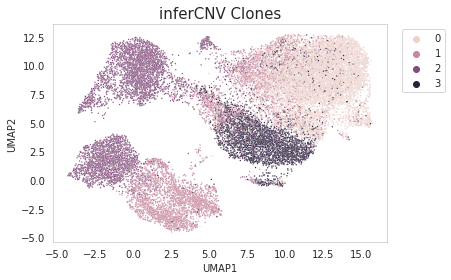

In [13]:
sns.set_style("whitegrid", {'axes.grid' : False})
scatter=sns.scatterplot(x=r310.obsm["X_umap"][:,0],y=r310.obsm["X_umap"][:,1], hue=kmeans,s=2)
scatter.legend(bbox_to_anchor= (1.03, 1) );
scatter.set_xlabel("UMAP1", fontsize = 10)
scatter.set_ylabel("UMAP2", fontsize = 10)
scatter.set_title("inferCNV Clones", fontsize = 15)

In [4]:
infer_full=pd.read_csv("N_infer_full_10.16.21")

In [40]:
r310.obs["inferCNV_clones"]=kmeans

In [3]:
clones=pd.DataFrame({"Clones":r310.obs["inferCNV_clones"]})
group_clones=clones.sort_values(by="Clones")

In [10]:
pre_barcodes=subsample(r310,"treatment",["pre"]).obs_names
on_barcodes=subsample(r310,"treatment",["on"]).obs_names
later_barcodes=subsample(r310,"treatment",["on_later"]).obs_names

<AxesSubplot:>

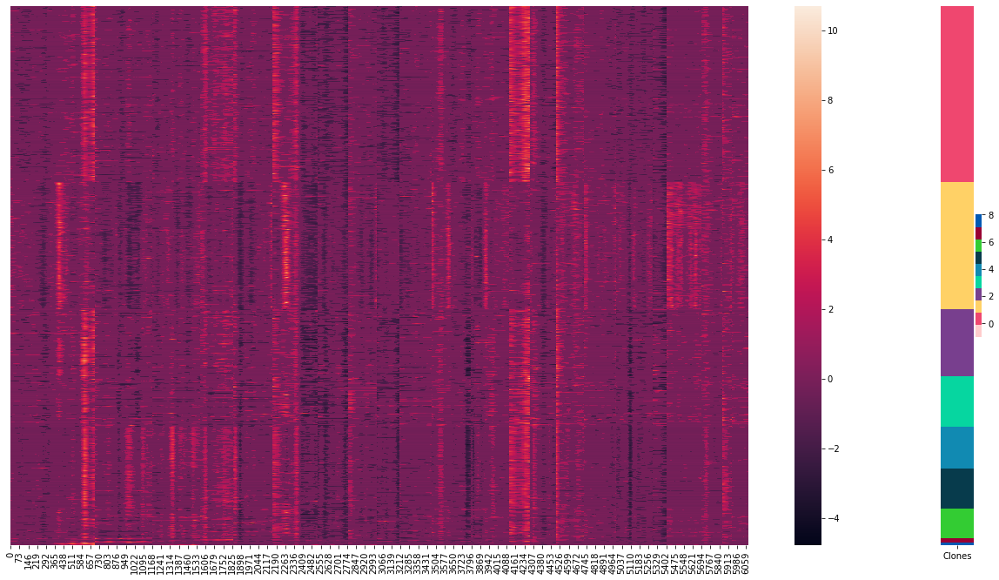

In [28]:
fig = plt.figure(figsize=(20,12))
ax1 = plt.subplot2grid((20,20), (0,0), colspan=19, rowspan=19)
ax3 = plt.subplot2grid((20,20), (0,19), colspan=1, rowspan=19)
sns.heatmap(stats.zscore(infer_full.loc[group_clones.index],axis=1),ax=ax1,yticklabels=False)
sns.heatmap(group_clones,ax=ax3,cmap=palette,yticklabels=False)

Text(0.5, 0.98, 'On Clones')

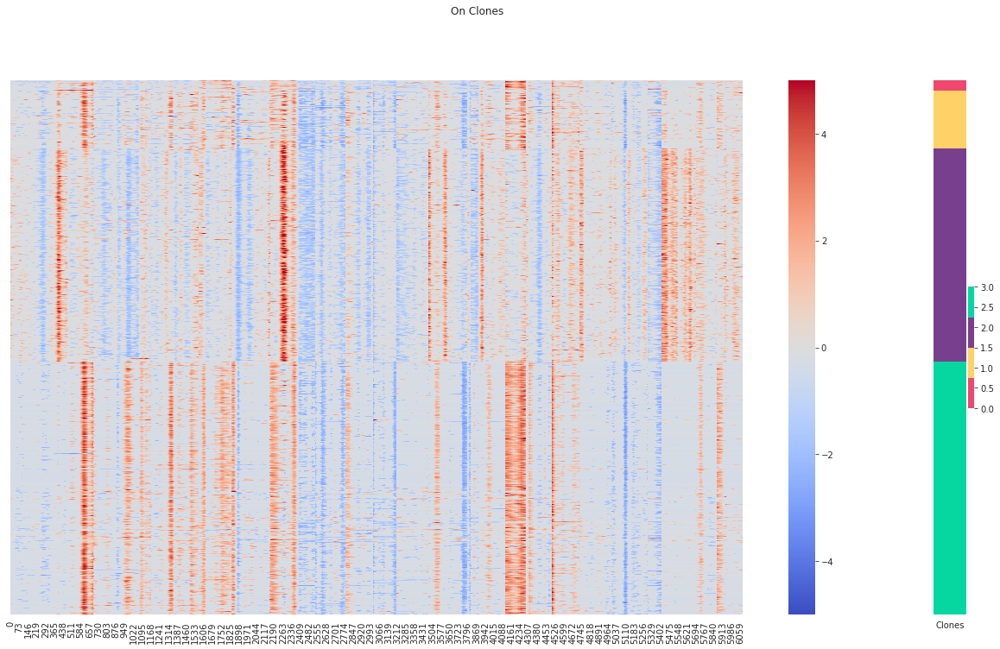

In [34]:
#clones=pd.DataFrame({"Clones":r310.obs["inferCNV_clones"]})
group_clones=clones.sort_values(by="Clones").loc[on_barcodes].sort_values(by="Clones")

fig = plt.figure(figsize=(20,12))
ax1 = plt.subplot2grid((20,20), (0,0), colspan=19, rowspan=19)
ax3 = plt.subplot2grid((20,20), (0,19), colspan=1, rowspan=19)
sns.heatmap(stats.zscore(infer_full.loc[group_clones.index],axis=1),ax=ax1,cmap='coolwarm',vmin=-5,vmax=5,yticklabels=False)
sns.heatmap(group_clones,ax=ax3,cmap=palette,yticklabels=False)
plt.suptitle("On Clones")

Text(0.5, 0.98, 'On_later Clones')

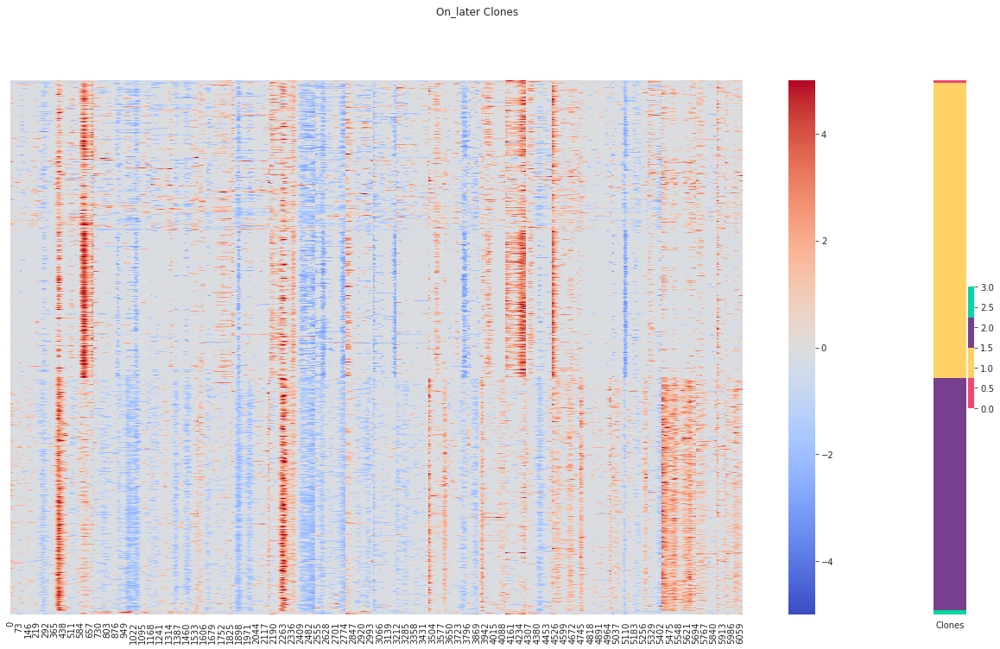

In [35]:
#clones=pd.DataFrame({"Clones":r310.obs["inferCNV_clones"]})
group_clones=clones.sort_values(by="Clones").loc[later_barcodes].sort_values(by="Clones")

fig = plt.figure(figsize=(20,12))
ax1 = plt.subplot2grid((20,20), (0,0), colspan=19, rowspan=19)
ax3 = plt.subplot2grid((20,20), (0,19), colspan=1, rowspan=19)
sns.heatmap(stats.zscore(infer_full.loc[group_clones.index],axis=1),ax=ax1,cmap='coolwarm',vmin=-5,vmax=5,yticklabels=False)
sns.heatmap(group_clones,ax=ax3,cmap=palette,yticklabels=False)
plt.suptitle("On_later Clones")

In [19]:
keep_ind=[]
for i in range(infer_full.shape[1]):
    counts=0
    for j in range(infer_full.shape[0]):
        if infer_full_np[j][i]>1.05 or infer_full_np[j][i]<.95:
            counts+=1
    if counts>1000:
        keep_ind.append(i)


filtered_infer_full=np.transpose(infer_full).iloc[keep_ind]

filtered_h5=reordered310[:,keep_ind]

In [20]:
y=[]
for i in filtered_h5.obs["treatment"]:
    if i=="pre":
        y.append(0)
    elif i=="on":
        y.append(1)
    else:
        y.append(2)

In [35]:
from sklearn import linear_model
clf = linear_model.Lasso(alpha=0.00001)
y=clone.obs["Diffusion component 1"]
X=np.transpose(filtered_infer_full)
clf.fit(X,y)

/home/lf2684/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 64.72451884579124, tolerance: 0.48080002675324196
  model = cd_fast.enet_coordinate_descent(


Lasso(alpha=1e-05)

Text(0, 0.5, 'DC 1')

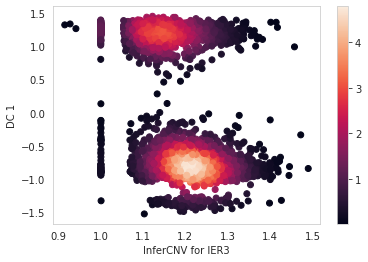

In [38]:
from scipy.stats import gaussian_kde

# Calculate the point density
x=X[X.columns[np.argmax(clf.coef_)]]

xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)


plt.scatter(x,y,c=z)
plt.colorbar()
#plt.plot(v,fit,color="red")
#plt.xlabel("inferCNV")
#plt.ylabel("Diffusion component 1")
#plt.title(X.columns[593]+" CNV Line of best fit")

#plt.scatter(X[X.columns[np.argmax(clf.coef_)]],y)
plt.xlabel("InferCNV for "+X.columns[np.argmax(clf.coef_)])
plt.ylabel("DC 1")

In [67]:
pos_corr=[]
neg_corr=[]
for i in range(len(filtered_infer_full.index)):
    if clf.coef_[i]>1:
        pos_corr.append(filtered_infer_full.index[i])
    if clf.coef_[i]<-1:
        neg_corr.append(filtered_infer_full.index[i])

### FUNCTIONS

In [31]:
def subsample(adata, select, key):
    #select is the column in adata.obs that we will subsample by
    #key is the entries in obs that we will select
    index=[]
    for i in range(len(adata.obs[select])):
        if adata.obs[select][i] in key:
            index.append(i)
    return adata[index,:]

In [3]:
#code from https://github.com/oliviaguest/gini/blob/master/gini.py
def gini(array):
    """Calculate the Gini coefficient of a numpy array."""
    # based on bottom eq:
    # http://www.statsdirect.com/help/generatedimages/equations/equation154.svg
    # from:
    # http://www.statsdirect.com/help/default.htm#nonparametric_methods/gini.htm
    # All values are treated equally, arrays must be 1d:
    array = array.flatten()
    if np.amin(array) < 0:
        # Values cannot be negative:
        array -= np.amin(array)
    # Values cannot be 0:
    array += 0.0000001
    # Values must be sorted:
    array = np.sort(array)
    # Index per array element:
    index = np.arange(1,array.shape[0]+1)
    # Number of array elements:
    n = array.shape[0]
    # Gini coefficient:
    return ((np.sum((2 * index - n  - 1) * array)) / (n * np.sum(array)))

In [5]:
def ttest_degs(adata,n_genes_per_cluster,annot):

    #pca of n_components
    sc.pp.pca(adata, n_comps= 50)

    #communities, graph, Q = sc.external.tl.phenograph(pd.DataFrame(adata.obsm['X_pca']), k = 30)

    #adata.obs['PhenoGraph_clusters'] = pd.Categorical(communities)
    #adata.uns['PhenoGraph_Q'] = Q

    sc.tl.rank_genes_groups(adata, annot , method='t-test', key_added = "t-test")

    ttest=pd.DataFrame()
    ttest_scores=pd.DataFrame()
    for i in np.unique(adata.obs[annot]):
        genelist=[]
        scores=[]
        counts=0
        tmp=sc.get.rank_genes_groups_df(adata,key='t-test',group=str(i))
        ttest_ii=tmp["names"]
        score_ii=tmp["scores"]
        j=0
        for j in range(len(ttest_ii)):
            if ("MT-" not in ttest_ii[j]) and ("RPS" not in ttest_ii[j]) and ("RPL" not in ttest_ii[j]):
                genelist.append(ttest_ii[j])
                scores.append(score_ii[j])

        ttest["Cluster "+str(i)]=genelist
        ttest_scores["Cluster "+str(i)]=scores
    return ttest,ttest_scores

In [6]:
def get_coords(arr):
    #arr=np.asarray(arr).flatten()
    coords=[0]
    labels=[arr[0]]
    tmp=0
    for i in range(len(arr)):
        if arr[i]!=arr[tmp]:
            coords.append(i)
            labels.append(arr[i])
            tmp=i
    coords.append(len(arr))
    return coords,labels

In [8]:
def make_heatmap(df, sig, adata):
    genes=df.loc[sig]
    heatmap=pd.DataFrame()
    adata_df=adata.to_df()
    for i in genes:
        if not pd.isnull(i):
            if i in adata_df.columns:
                heatmap[i]=adata_df[i]
            else:
                heatmap[i]=[0 for i in range(adata_df.shape[0])]
    return heatmap

def full_heatmap(df, sig, adata, vmax=3, thresh=200,mean_thresh=.1,exclude=None):
    palette={0:"#EF476F",1:"#FFD166",2:"#783F8E",3:"#06D6A0"}
    
    pre=subsample(adata,"treatment",['pre'])
    pre_heatmap=make_heatmap(df, sig, pre)
    pre_clone_df=pd.DataFrame({"clone":pre.obs["inferCNV_clones"],"id":pre.obs_names})
    pre_heatmap=pd.concat((pre_clone_df,pre_heatmap),axis=1).sort_values(by="clone")
    pre_clones=list(pre_heatmap["clone"])
    pre_heatmap=pre_heatmap.drop(["id","clone"],axis=1)

    on=subsample(adata,"treatment",['on'])
    on_heatmap=make_heatmap(df, sig, on)
    on_clone_df=pd.DataFrame({"clone":on.obs["inferCNV_clones"],"id":on.obs_names})
    on_heatmap=pd.concat((on_clone_df,on_heatmap),axis=1).sort_values(by="clone")
    on_clones=list(on_heatmap["clone"])
    on_heatmap=on_heatmap.drop(["id","clone"],axis=1)
    
    
    later=subsample(adata,"treatment",['on_later'])
    later_heatmap=make_heatmap(df, sig, later)
    later_clone_df=pd.DataFrame({"clone":later.obs["inferCNV_clones"],"id":later.obs_names})
    later_heatmap=pd.concat((later_clone_df,later_heatmap),axis=1).sort_values(by="clone")
    later_clones=list(later_heatmap["clone"])
    later_heatmap=later_heatmap.drop(["id","clone"],axis=1)
    
    heatmap=pd.concat((pre_heatmap, on_heatmap, later_heatmap),axis=0)
    heatmap=np.transpose(heatmap)
    
    #clones=np.asarray([pre_clones]+[on_clones]+[later_clones]).flatten()
    clones=pre_clones+on_clones+later_clones
    drop=[]

    for i in heatmap.index:
        #nonzero=0
        mean=np.mean(heatmap.loc[i])
        #for j in heatmap.loc[i]:
        #    if j>0:
        #        nonzero+=1
        #print(nonzero)
        #if nonzero<thresh:
        #    drop.append(i)
        if mean<mean_thresh:
            drop.append(i)
        heatmap.loc[i]=stats.zscore(heatmap.loc[i])    
    heatmap=heatmap.drop(drop)

    mean_exp=pd.DataFrame({"Mean_exp":np.mean(heatmap,axis=0)}).T
    #heatmap=pd.concat((mean_exp,heatmap))

    if exclude is not None:
        heatmap=heatmap.drop(exclude)

    fig = plt.figure(figsize=(20,12))
    ax1 = plt.subplot2grid((22,20), (1,0), colspan=19, rowspan=19)
    ax2 = plt.subplot2grid((22,20), (21,0), colspan=19, rowspan=1,sharex = ax1)
    ax4 = plt.subplot2grid((22,20), (20,0), colspan=19, rowspan=1,sharex = ax1)
    ax5 = plt.subplot2grid((22,20), (0,0), colspan=19, rowspan=1,sharex = ax1)
    ax3 = plt.subplot2grid((22,20), (1,19), colspan=1, rowspan=19)


    sns.heatmap(heatmap,ax=ax1,cbar=False,cmap='bwr',vmin=-1*vmax,vmax=vmax)
    ax1.set_xticks([0,len(pre_heatmap),len(pre_heatmap)+len(on_heatmap)])

    #ax1.set_yticks(rotation=0) 
    ax1.set_yticklabels(ax1.get_yticklabels(),rotation = 0)
    coords=[0,len(pre_heatmap),len(pre_heatmap)+len(on_heatmap),len(pre_heatmap)+len(on_heatmap)+len(later_heatmap)]
    
    txt=["pre","on","on_later"]
    colors=["#d4d4d4","#b0b0b0","#8a8a8a"]
    for i in range(3):
        ax2.barh([-0.15], coords[i+1]-coords[i], left=coords[i], height=1.2, color=colors[i])
        ax2.text((coords[i]+coords[i+1])/2, -0.5, txt[i],fontsize=15 )
    ax2.set_yticks([])
    
    coords,labels=get_coords(clones)
    txt=labels
    colors=[palette[i] for i in labels]
    
    for i in range(len(txt)):
        ax4.barh([-0.15], coords[i+1]-coords[i], left=coords[i], height=1.2, color=colors[i])
        ax4.text((coords[i]+coords[i+1])/2, -0.5, txt[i],fontsize=15 )
    ax4.set_yticks([])  
    
    sns.heatmap(mean_exp,ax=ax5,cbar=False,cmap='bwr',vmin=-1*vmax,vmax=vmax,xticklabels=False)
    ax5.set_yticklabels(ax5.get_yticklabels(),rotation = 0)
    ax5.set_title(sig)
    #ax1.set_xticks(None)
        
    cmap = mpl.cm.bwr
    #norm = mpl.colors.Normalize(vmin=np.min(np.asarray(heatmap)), vmax=vmax)
    norm = mpl.colors.Normalize(vmin=-1*vmax, vmax=vmax)
    #norm = mpl.colors.Normalize(vmin=-2, vmax=2)
    cb1 = mpl.colorbar.ColorbarBase(ax3, cmap=cmap,
                                    norm=norm,
                                    orientation='vertical')
    fig.show()
    plt.tight_layout()
    plt.savefig("figures/supp_7c.pdf",format='pdf',bbox_inches='tight')
    return(heatmap.index)

    #sns.heatmap([[0 for i in range(len(pre))]+[1 for i in range(len(on))]+[0 for i in range(len(later))]],
            #ax=ax2,  annot=True, cmap="YlGnBu", cbar=False, xticklabels=False, yticklabels=False)

In [11]:
def full_heatmap(df, sig, adata, vmax=3, thresh=200,mean_thresh=.1,exclude=None):
    palette={0:"#EF476F",1:"#FFD166",2:"#783F8E",3:"#06D6A0"}
    
    pre=subsample(adata,"treatment",['pre'])
    pre_heatmap=make_heatmap(df, sig, pre)
    pre_clone_df=pd.DataFrame({"clone":pre.obs["inferCNV_clones"],"id":pre.obs_names})
    pre_heatmap=pd.concat((pre_clone_df,pre_heatmap),axis=1).sort_values(by="clone")
    pre_clones=list(pre_heatmap["clone"])
    pre_heatmap=pre_heatmap.drop(["id","clone"],axis=1)

    on=subsample(adata,"treatment",['on'])
    on_heatmap=make_heatmap(df, sig, on)
    on_clone_df=pd.DataFrame({"clone":on.obs["inferCNV_clones"],"id":on.obs_names})
    on_heatmap=pd.concat((on_clone_df,on_heatmap),axis=1).sort_values(by="clone")
    on_clones=list(on_heatmap["clone"])
    on_heatmap=on_heatmap.drop(["id","clone"],axis=1)
    
    
    later=subsample(adata,"treatment",['on_later'])
    later_heatmap=make_heatmap(df, sig, later)
    later_clone_df=pd.DataFrame({"clone":later.obs["inferCNV_clones"],"id":later.obs_names})
    later_heatmap=pd.concat((later_clone_df,later_heatmap),axis=1).sort_values(by="clone")
    later_clones=list(later_heatmap["clone"])
    later_heatmap=later_heatmap.drop(["id","clone"],axis=1)
    
    heatmap=pd.concat((pre_heatmap, on_heatmap, later_heatmap),axis=0)
    heatmap=np.transpose(heatmap)
    
    #clones=np.asarray([pre_clones]+[on_clones]+[later_clones]).flatten()
    clones=pre_clones+on_clones+later_clones
    drop=[]

    for i in heatmap.index:
        #nonzero=0
        mean=np.mean(heatmap.loc[i])
        #for j in heatmap.loc[i]:
        #    if j>0:
        #        nonzero+=1
        #print(nonzero)
        #if nonzero<thresh:
        #    drop.append(i)
        if mean<mean_thresh:
            drop.append(i)
        heatmap.loc[i]=stats.zscore(heatmap.loc[i])    
    heatmap=heatmap.drop(drop)

    mean_exp=pd.DataFrame({"Mean_exp":np.mean(heatmap,axis=0)}).T
    #heatmap=pd.concat((mean_exp,heatmap))

    if exclude is not None:
        heatmap=heatmap.drop(exclude)

    fig = plt.figure(figsize=(20,12))
    ax1 = plt.subplot2grid((22,20), (0,0), colspan=19, rowspan=19)
    ax2 = plt.subplot2grid((22,20), (20,0), colspan=19, rowspan=1,sharex = ax1)
    ax4 = plt.subplot2grid((22,20), (19,0), colspan=19, rowspan=1,sharex = ax1)
    #ax5 = plt.subplot2grid((22,20), (0,0), colspan=19, rowspan=1,sharex = ax1)
    ax3 = plt.subplot2grid((22,20), (0,19), colspan=1, rowspan=19)


    sns.heatmap(heatmap,ax=ax1,cbar=False,cmap='bwr',vmin=-1*vmax,vmax=vmax)
    ax1.set_xticks([0,len(pre_heatmap),len(pre_heatmap)+len(on_heatmap)])

    #ax1.set_yticks(rotation=0) 
    ax1.set_yticklabels(ax1.get_yticklabels(),rotation = 0)
    coords=[0,len(pre_heatmap),len(pre_heatmap)+len(on_heatmap),len(pre_heatmap)+len(on_heatmap)+len(later_heatmap)]
    
    txt=["pre","on","on_later"]
    colors=["#d4d4d4","#b0b0b0","#8a8a8a"]
    for i in range(3):
        ax2.barh([-0.15], coords[i+1]-coords[i], left=coords[i], height=1.2, color=colors[i])
        ax2.text((coords[i]+coords[i+1])/2, -0.5, txt[i],fontsize=15 )
    ax2.set_yticks([])
    
    coords,labels=get_coords(clones)
    txt=labels
    colors=[palette[i] for i in labels]
    
    for i in range(len(txt)):
        ax4.barh([-0.15], coords[i+1]-coords[i], left=coords[i], height=1.2, color=colors[i])
        ax4.text((coords[i]+coords[i+1])/2, -0.5, txt[i],fontsize=15 )
    ax4.set_yticks([])  

        
    cmap = mpl.cm.bwr
    #norm = mpl.colors.Normalize(vmin=np.min(np.asarray(heatmap)), vmax=vmax)
    norm = mpl.colors.Normalize(vmin=-1*vmax, vmax=vmax)
    #norm = mpl.colors.Normalize(vmin=-2, vmax=2)
    cb1 = mpl.colorbar.ColorbarBase(ax3, cmap=cmap,
                                    norm=norm,
                                    orientation='vertical')
    fig.show()
    plt.tight_layout()
    plt.savefig("figures/supp_7c.pdf",format='pdf',bbox_inches='tight')
    return(heatmap.index)

In [9]:
selected_genes=pd.DataFrame({"selected":['SOX10', '  ','VIM','   ','TAP1', 'HLA-A','B2M','NLRC5', '    ','MIF', 
                                         'GPX4', 'FTH1', 'FTL', 'GSTP1', 'YWHAB', 'YWHAZ', 
                                         'WARS']}).T

In [20]:
sns.set(font_scale=1.4)

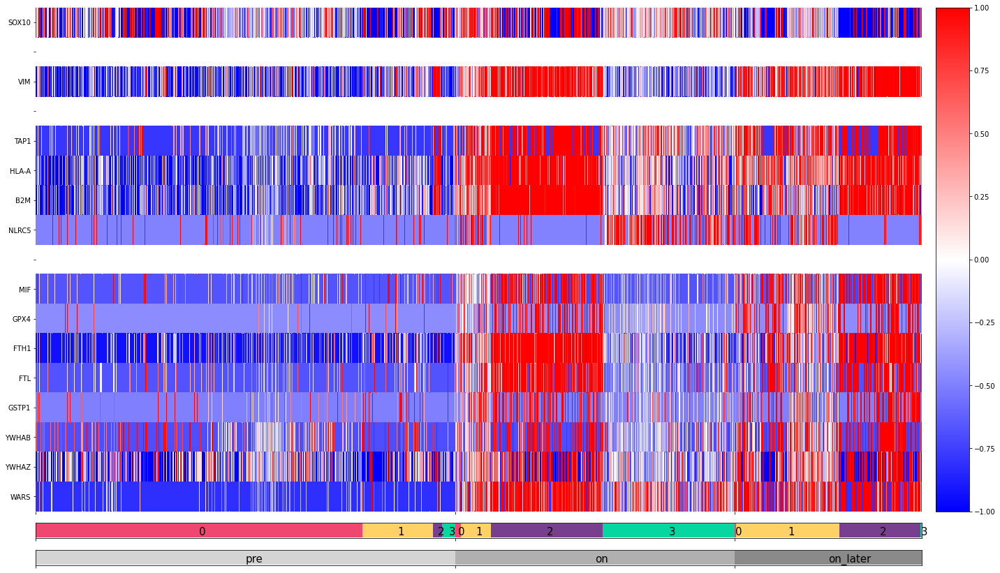

In [12]:
genes=full_heatmap(selected_genes, "selected",r310,vmax=1,thresh=300,mean_thresh=0)